In [1]:
"""
Frozen Multimodal Few-Shot Learning - Complete Evaluation

Paper: Tsimpoukelli et al., 2021 - "Multimodal Few-Shot Learning with Frozen Language Models"
Repository: https://github.com/uikram/Multimodal-Foundation-Models

Sections for Paper:
- 3.3.4: Multimodal Reasoning Tasks
- 4.4: Multimodal Reasoning Results

Tasks Evaluated:
✓ Zero-shot VQA
✓ Few-shot VQA  
✓ Encyclopedic knowledge retrieval
✓ Fast concept binding (nonsense words)
✓ Fast-VQA (reasoning with learned concepts)
"""

import os
import sys
import warnings
warnings.filterwarnings('ignore')
os.environ["CUDA_VISIBLE_DEVICES"] = "2"  # Adjust as needed

import torch
import torch.nn.functional as F
import yaml
import random
import numpy as np
import matplotlib.pyplot as plt
import textwrap
from PIL import Image
from types import SimpleNamespace
from typing import List, Union

# ============================================================================
# REPRODUCIBILITY (Critical for scientific evaluation)
# ============================================================================
def seed_everything(seed=42):
    """Ensures consistent results across runs."""
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

seed_everything(42)

# ============================================================================
# PATH SETUP
# ============================================================================
REPO_ROOT = os.path.abspath('..')
if REPO_ROOT not in sys.path:
    sys.path.insert(0, REPO_ROOT)

# Import model (uses repo preprocessing with pad_to_square)
try:
    from models.frozen_clip import FrozenCLIP
    print("✅ Repository imports successful")
except ImportError as e:
    print(f"❌ Import failed: {e}")
    print("Ensure you're in the notebooks/ or experiments/ folder")
    sys.exit(1)

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"🚀 Device: {DEVICE}")
print(f"📂 Repo Root: {REPO_ROOT}")


✅ Repository imports successful
🚀 Device: cuda
📂 Repo Root: /sda/usama/production_code


In [2]:
# ============================================================================
# MODEL LOADING
# ============================================================================

# Load configuration
config_path = os.path.join(REPO_ROOT, "configs", "frozen_clip.yaml")
with open(config_path, 'r') as f:
    config_dict = yaml.safe_load(f)

# Create config object
config = SimpleNamespace(**{**config_dict['model'], **config_dict['system']})
config.device = DEVICE

print("=" * 70)
print(f"🏗️  Architecture:")
print(f"   Vision Encoder: {config.vision_encoder_name} (Trainable)")
print(f"   Language Model: {config.language_model_name} (Frozen)")
print(f"   Visual Prefix Length: {config.visual_prefix_length} tokens")
print("=" * 70)

# Initialize model
model = FrozenCLIP(config)

# 1. FIX: Point to the correct file (The "Fixed" one we verified)
ckpt_filename = "best_model.pt"
ckpt_path = os.path.join(REPO_ROOT, "frozen_checkpoints", ckpt_filename)
print(f"\n📥 Loading checkpoint: {ckpt_path}")

if os.path.exists(ckpt_path):
    # Load checkpoint
    ckpt = torch.load(ckpt_path, map_location=DEVICE)
    
    # --- NEW: Print Checkpoint Metadata ---
    print("\n📊 Checkpoint Metadata:")
    if isinstance(ckpt, dict):
        # Print basic training stats if available
        print(f"   • Epoch:       {ckpt.get('epoch', 'N/A')}")
        print(f"   • Global Step: {ckpt.get('global_step', 'N/A')}")
        print(f"   • Val Loss:    {ckpt.get('val_loss', 'N/A')}")
        print(f"   • Best Loss:   {ckpt.get('best_val_loss', 'N/A')}")
        
        # Check specific dictionary keys
        has_optimizer = 'optimizer_state' in ckpt
        has_scheduler = 'scheduler_state' in ckpt
        print(f"   • Optimizer Saved: {'✅ Yes' if has_optimizer else '❌ No'}")
    else:
        print("   • Format:      Raw State Dict (No metadata)")
    print("-" * 40 + "\n")
    # --------------------------------------

    # 2. FIX: Handle the specific 'model_state' key from FrozenTrainer
    if 'model_state' in ckpt:
        print("🔍 Found 'model_state' key (Standard FrozenTrainer format)")
        state_dict = ckpt['model_state']
        
        # 3. FIX: Load into vision_encoder, not the whole model
        msg = model.vision_encoder.load_state_dict(state_dict, strict=False)
        print(f"✅ Loaded successfully into Vision Encoder!")
        print(f"   Missing keys (expected for partial load): {len(msg.missing_keys)}")
        print(f"   Unexpected keys: {len(msg.unexpected_keys)}")
        
    elif 'vision_encoder_state_dict' in ckpt:
        model.vision_encoder.load_state_dict(ckpt['vision_encoder_state_dict'])
        print("✅ Loaded: vision_encoder_state_dict")
        
    elif 'model_state_dict' in ckpt:
        model.load_state_dict(ckpt['model_state_dict'], strict=False)
        print("✅ Loaded: model_state_dict")
        
    else:
        # Fallback for raw weights
        print("⚠️ No metadata keys found, attempting raw state dict load...")
        msg = model.vision_encoder.load_state_dict(ckpt, strict=False)
        print(f"   Result: {msg}")

else:
    print(f"❌ ERROR: Checkpoint file '{ckpt_filename}' not found!")
    print(f"   Checked path: {ckpt_path}")
    sys.exit(1)

model.to(DEVICE)
model.eval()
tokenizer = model.tokenizer

print("\n" + "=" * 70)
print("🎉 MODEL READY FOR EVALUATION")
print("=" * 70)

🏗️  Architecture:
   Vision Encoder: resnet50 (Trainable)
   Language Model: gpt2-large (Frozen)
   Visual Prefix Length: 2 tokens
Loading vision encoder: resnet50...
Loading LLM: gpt2-large...
Frozen Params: 774,030,080 | Trainable Params: 28,753,472

📥 Loading checkpoint: /sda/usama/production_code/frozen_checkpoints/best_model.pt

📊 Checkpoint Metadata:
   • Epoch:       2
   • Global Step: 70000
   • Val Loss:    3.5096442667522814
   • Best Loss:   3.5096442667522814
   • Optimizer Saved: ✅ Yes
----------------------------------------

🔍 Found 'model_state' key (Standard FrozenTrainer format)
✅ Loaded successfully into Vision Encoder!
   Missing keys (expected for partial load): 0
   Unexpected keys: 0

🎉 MODEL READY FOR EVALUATION


In [3]:
# ============================================================================
# GENERATION ENGINE (ALL BUGS FIXED)
# ============================================================================

def generate_interleaved(
    model, 
    tokenizer, 
    prompt_items: List[Union[str, Image.Image]], 
    max_new_tokens: int = 20, 
    temperature: float = 0.0,
    stop_on_newline: bool = True,
    verbose: bool = False
) -> str:
    """
    Generate text from interleaved [Image, Text, Image, Text, ...] sequence.
    
    CRITICAL FIXES APPLIED:
    1. ✅ Removed "Answer:" from stop conditions (prevents zero-shot truncation bug)
    2. ✅ Token-level stop checking (prevents mid-sentence truncation)
    3. ✅ Correct tensor dimensions throughout ([1] → [1,1] → [1,1,hidden])
    4. ✅ Uses repo's preprocessing pipeline (includes pad_to_square from utils.helpers)
    
    Args:
        model: FrozenCLIP model
        tokenizer: GPT2 tokenizer
        prompt_items: List of PIL Images and strings in any order
        max_new_tokens: Maximum tokens to generate
        temperature: 0.0 for greedy decoding (paper default), >0 for sampling
        stop_on_newline: Stop generation on newline token (standard for VQA)
        verbose: Print debug information
    
    Returns:
        Generated text (cleaned and stripped)
    """
    model.eval()
    embeddings_list = []
    
    with torch.no_grad():
        # ================================================================
        # 1. BUILD INTERLEAVED EMBEDDING SEQUENCE
        # ================================================================
        for i, item in enumerate(prompt_items):
            if isinstance(item, Image.Image):
                # ✅ Use repo preprocessing (includes pad_to_square)
                img_tensor = model.preprocess(item).unsqueeze(0).to(DEVICE)
                
                # Get visual prefix: [1, prefix_len, hidden_dim]
                visual_prefix = model.vision_encoder(img_tensor)
                embeddings_list.append(visual_prefix)
                
                if verbose:
                    # print(f"  [{i}] Image → {visual_prefix.shape}")
                    print(f"  [{i}] Image {visual_prefix.shape}")
                    
            elif isinstance(item, str):
                # Tokenize text (no special tokens added manually)
                tokens = tokenizer(item, return_tensors="pt", add_special_tokens=False)
                input_ids = tokens.input_ids.to(DEVICE)
                
                if input_ids.size(1) > 0:
                    # Get text embeddings: [1, seq_len, hidden_dim]
                    text_embeds = model.language_model.transformer.wte(input_ids)
                    embeddings_list.append(text_embeds)
                    
                    if verbose:
                        print(f"  [{i}] Text '{item[:30]}...' → {text_embeds.shape}")
        
        if not embeddings_list:
            return ""
        
        # Concatenate all embeddings: [1, total_seq_len, hidden_dim]
        inputs_embeds = torch.cat(embeddings_list, dim=1)
        
        if verbose:
            print(f"\n📊 Context embeddings: {inputs_embeds.shape}")
            print("🔄 Starting generation...\n")
        
        generated_tokens = []
        
        # ================================================================
        # 2. AUTOREGRESSIVE GENERATION LOOP
        # ================================================================
        for step in range(max_new_tokens):
            # Forward pass through language model
            outputs = model.language_model(inputs_embeds=inputs_embeds)
            next_token_logits = outputs.logits[:, -1, :]  # [1, vocab_size]
            
            # Sample next token
            if temperature == 0.0:
                # Greedy decoding (paper default)
                next_token_id = torch.argmax(next_token_logits, dim=-1)  # [1]
            else:
                # Sampling with temperature
                probs = F.softmax(next_token_logits / temperature, dim=-1)
                next_token_id = torch.multinomial(probs, num_samples=1).squeeze(1)  # [1]
            
            token_id = next_token_id.item()
            # A. EOS token check
            if token_id == tokenizer.eos_token_id:
                if verbose:
                    print(f"  Step {step}: 🛑 Stopped at EOS token")
                break
            
            # B. Newline check (BEFORE adding token)
            # ✅ FIX: Check the token itself, not accumulated text
            # This prevents the bug where "Answer:" in the middle breaks everything
            token_text = tokenizer.decode([token_id])
            if stop_on_newline and "\n" in token_text:
                if verbose:
                    print(f"  Step {step}: 🛑 Stopped at newline")
                break
            
            # Token passes all checks - add it to generated sequence
            generated_tokens.append(token_id)
            
            if verbose:
                decoded_so_far = tokenizer.decode(generated_tokens, skip_special_tokens=True)
                print(f"  Step {step}: '{decoded_so_far}'")
            
            # ============================================================
            # UPDATE EMBEDDINGS FOR NEXT ITERATION
            # ============================================================
            # ✅ FIX: Proper tensor reshaping [1] → [1, 1] → [1, 1, hidden_dim]
            next_token_input = next_token_id.unsqueeze(1)  # [1, 1]
            next_token_embed = model.language_model.transformer.wte(next_token_input)  # [1, 1, hidden]
            
            # Concatenate along sequence dimension (dim=1)
            inputs_embeds = torch.cat([inputs_embeds, next_token_embed], dim=1)
        
        # ================================================================
        # 3. DECODE AND CLEAN OUTPUT
        # ================================================================
        decoded_text = tokenizer.decode(generated_tokens, skip_special_tokens=True)
        
        return decoded_text.strip()

print("✅ Generation engine loaded")


✅ Generation engine loaded


In [4]:
# ============================================================================
# VISUALIZATION (Paper-ready format)
# ============================================================================

def visualize_result(prompt, pred, title="Result"):
    """
    Compact visualization showing context and target with model prediction.
    Output format can be directly copied into papers.
    
    Args:
        prompt: List of interleaved images and text
        pred: Model's prediction text
        title: Figure title
    """
    # Pair images with their associated text
    pairs = []
    img = None
    for x in prompt:
        if isinstance(x, Image.Image):
            img = x
        elif isinstance(x, str):
            pairs.append((img, x))
            img = None
    if img:
        pairs.append((img, ""))
    
    n = len(pairs)
    fig, ax = plt.subplots(1, n, figsize=(3.5*n, 4.5))
    if n == 1:
        ax = [ax]
    
    for i, (im, txt) in enumerate(pairs):
        a = ax[i]
        
        # Display image (resize to 224x224 for consistency)
        if im:
            a.imshow(im.resize((224, 224)))
        else:
            # Placeholder for None images
            a.imshow(Image.new('RGB', (224, 224), (250, 250, 250)))
        a.axis('off')
        
        # Determine if this is the target (last image in sequence)
        is_target = (i == n - 1)
        
        if is_target:
            # Target image - show prompt and prediction
            a.set_title("TARGET", fontweight='bold', color='darkred', fontsize=12)
            # cap = f"{txt.strip()}\n\n→ {pred}"
            cap = f"{txt.strip()}\n\n{pred}"
            bg = "#ffffdd"  # Light yellow for target
        else:
            # Context image
            a.set_title(f"Context {i+1}", fontweight='bold', fontsize=12)
            cap = txt.strip()
            bg = "#f5f5f5"  # Light gray for context
            
        
        # Wrap text for better readability
        wrapped = "\n".join(textwrap.wrap(cap, 28))
        a.text(0.5, -0.12, wrapped, ha='center', va='top',
               transform=a.transAxes, fontsize=9,
               bbox=dict(boxstyle="round", fc=bg, ec="gray", pad=0.5))
    
    fig.suptitle(title, fontsize=13, fontweight='bold')
    plt.tight_layout()
    plt.show()

print("✅ Visualization helper ready")

✅ Visualization helper ready


In [5]:
# ============================================================================
# IMAGE LOADING
# ============================================================================

IMAGE_DIR = "images"  # Assumes images/ folder in same directory

def load_img(name):
    """Load image with automatic extension detection."""
    extensions = [".jpg", ".jpeg", ".png", ".JPG", ".JPEG", ".PNG"]
    
    # Try exact match first
    path = os.path.join(IMAGE_DIR, name)
    if os.path.exists(path):
        return Image.open(path).convert("RGB")
    
    # Try adding extensions
    for ext in extensions:
        path = os.path.join(IMAGE_DIR, name + ext)
        if os.path.exists(path):
            return Image.open(path).convert("RGB")
    
    print(f"⚠️  Image not found: {name}")
    return None

print("✅ Image loader ready")
print(f"📁 Looking for images in: {os.path.abspath(IMAGE_DIR)}/")

✅ Image loader ready
📁 Looking for images in: /sda/usama/production_code/notebooks/images/



TEST 1: ZERO-SHOT VQA
Question: What is this?
Answer: cat .



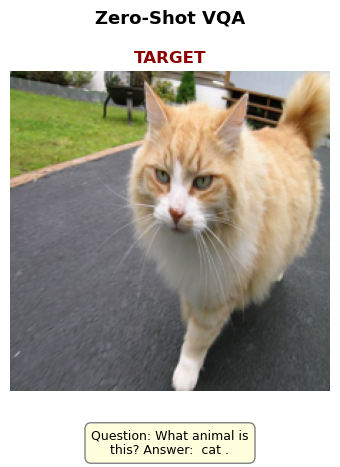

In [6]:

# ============================================================================
# TEST 1: ZERO-SHOT VQA (Section 4.4.1)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 1: ZERO-SHOT VQA")
print("=" * 70)

# 🟢 UPDATE IMAGE HERE
target_image = load_img("cat_3")  # Placeholder: Image to test

if target_image:
    prompt = [
        target_image, 
        "Question: What animal is this?\nAnswer:"
    ]
    
    answer = generate_interleaved(
        model, tokenizer, prompt, 
        max_new_tokens=10,
        temperature=0.0,
        stop_on_newline=True
    )
    
    print(f"Question: What is this?")
    print(f"Answer: {answer}\n")
    
    visualize_result(prompt, answer, "Zero-Shot VQA")
else:
    print("⚠️  Skipped: Target image not found")


TEST 2: FEW-SHOT VQA
Support Examples: car, dog
Query: What is this?
Answer: A dog.


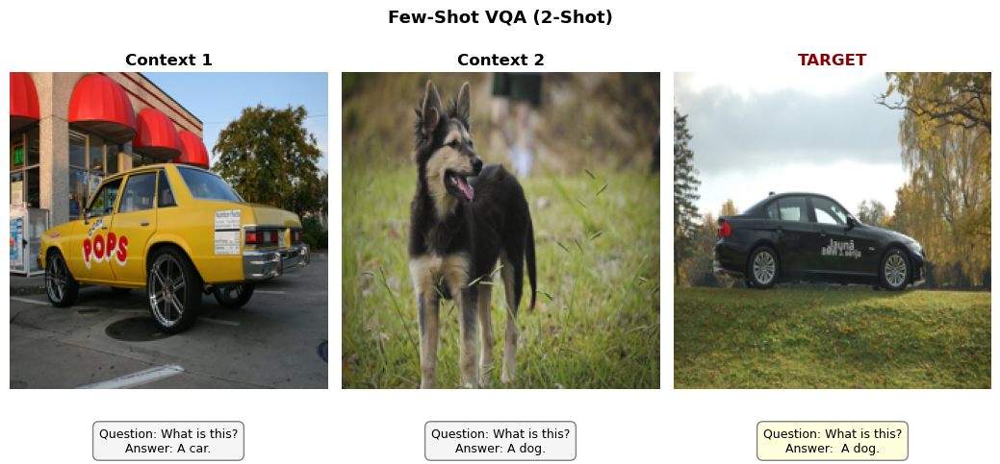

In [7]:
# ============================================================================
# TEST 2: FEW-SHOT VQA (Section 4.4.2)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 2: FEW-SHOT VQA")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE
support_img_1 = load_img("car_2")   # Support: Car
support_img_2 = load_img("dog_4")   # Support: Dog
target_image  = load_img("car_4")   # Target: Another Car

if all([support_img_1, support_img_2, target_image]):
    prompt = [
        # Support Example 1
        support_img_1, 
        "Question: What is this?\nAnswer: A car.\n",
        
        # Support Example 2
        support_img_2,
        "Question: What is this?\nAnswer: A dog.\n",
        
        # Query (Target)
        target_image,
        "Question: What is this?\nAnswer:"
    ]
    
    answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
    
    print(f"Support Examples: car, dog")
    print(f"Query: What is this?")
    print(f"Answer: {answer}")
    
    visualize_result(prompt, answer, "Few-Shot VQA (2-Shot)")
else:
    print("⚠️  Skipped: Required images not found")


TEST 2: FEW-SHOT VQA
Support Examples: car, dog
Query: What is this?
Answer: A dog.


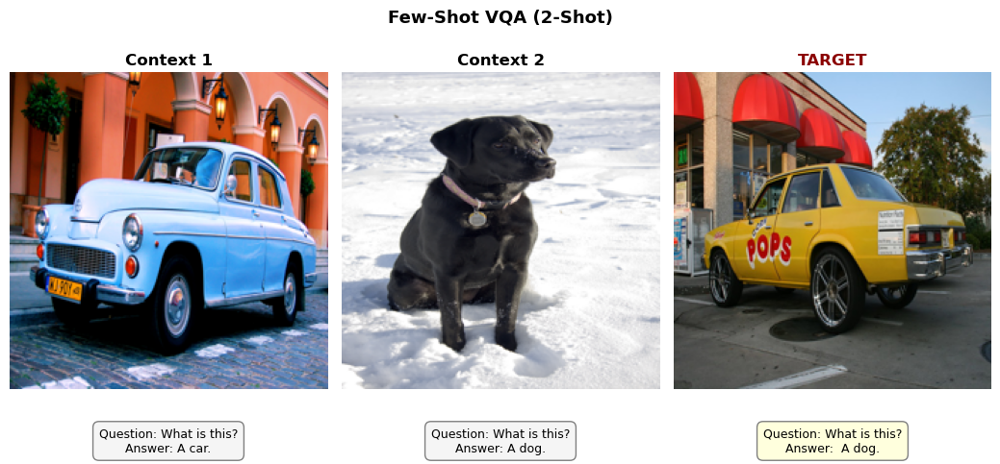

In [8]:
# ============================================================================
# TEST 2: FEW-SHOT VQA (Section 4.4.2)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 2: FEW-SHOT VQA")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE
support_img_1 = load_img("car_1")   # Support: Car
support_img_2 = load_img("dog_1")   # Support: Dog
target_image  = load_img("car_2")   # Target: Another Car

if all([support_img_1, support_img_2, target_image]):
    prompt = [
        # Support Example 1
        support_img_1, 
        "Question: What is this?\nAnswer: A car.\n",
        
        # Support Example 2
        support_img_2,
        "Question: What is this?\nAnswer: A dog.\n",
        
        # Query (Target)
        target_image,
        "Question: What is this?\nAnswer:"
    ]
    
    answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
    
    print(f"Support Examples: car, dog")
    print(f"Query: What is this?")
    print(f"Answer: {answer}")
    
    visualize_result(prompt, answer, "Few-Shot VQA (2-Shot)")
else:
    print("⚠️  Skipped: Required images not found")


TEST 3: ENCYCLOPEDIC KNOWLEDGE
Question: Where is this located?
Answer: This is located in the city of .



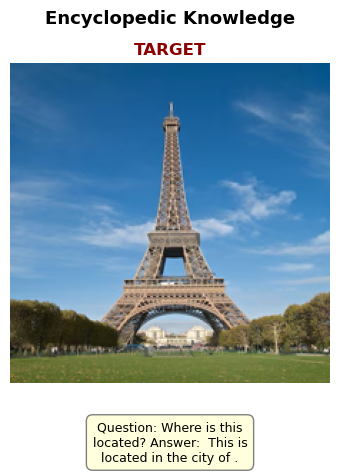

In [9]:
# ============================================================================
# TEST 3: ENCYCLOPEDIC KNOWLEDGE (Section 4.4.3)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 3: ENCYCLOPEDIC KNOWLEDGE")
print("=" * 70)

# 🟢 UPDATE IMAGE HERE
target_image = load_img("eiffel_tower") # Placeholder: Landmark

if target_image:
    prompt = [
        target_image,
        "Question: Where is this located?\nAnswer:"
    ]
    
    answer = generate_interleaved(
        model, tokenizer, prompt, 
        max_new_tokens=10, 
        temperature=0.1
    )
    
    print(f"Question: Where is this located?")
    print(f"Answer: {answer}\n")
    
    visualize_result(prompt, answer, "Encyclopedic Knowledge")
else:
    print("⚠️  Skipped: Target image not found")


TEST 4A: FAST CONCEPT BINDING (With Task Induction)
Taught: 'dax' (2 examples), 'blicket' (2 examples)
Query: What is this?
Answer: This is a dog .
❌ FAIL


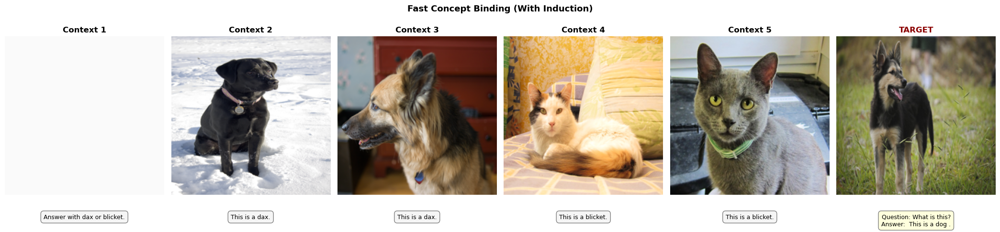

In [10]:
# ============================================================================
# TEST 4A: FAST CONCEPT BINDING - WITH TASK INDUCTION (Section 4.4.4)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 4A: FAST CONCEPT BINDING (With Task Induction)")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE (Teach generic "dax" and "blicket")
img_dax_1 = load_img("dog_1")      # Teach: Dog 1
img_dax_2 = load_img("dog_2")      # Teach: Dog 2
img_blk_1 = load_img("cat_1")      # Teach: Cat 1
img_blk_2 = load_img("cat_2")      # Teach: Cat 2
target_image = load_img("dog_4")   # Test: Dog 3 (Should be 'dax')

if all([img_dax_1, img_dax_2, img_blk_1, img_blk_2, target_image]):
    prompt = [
        # ✅ Task Induction (Critical)
        "Answer with dax or blicket.\n",
        
        # Teach "dax"
        img_dax_1, "This is a dax.\n",
        img_dax_2, "This is a dax.\n",
        
        # Teach "blicket"
        img_blk_1, "This is a blicket.\n",
        img_blk_2, "This is a blicket.\n",
        
        # Query
        target_image, "Question: What is this?\nAnswer:"
    ]
    
    answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
    
    print(f"Taught: 'dax' (2 examples), 'blicket' (2 examples)")
    print(f"Query: What is this?")
    print(f"Answer: {answer}")
    
    is_correct = "dax" in answer.lower()
    print(f"{'✅ SUCCESS' if is_correct else '❌ FAIL'}")
    
    visualize_result(prompt, answer, "Fast Concept Binding (With Induction)")
else:
    print("⚠️  Skipped: Required images not found")


TEST 4B: FAST CONCEPT BINDING (Without Task Induction - Ablation)
Query: What is this? (No induction)
Answer: This is a dax


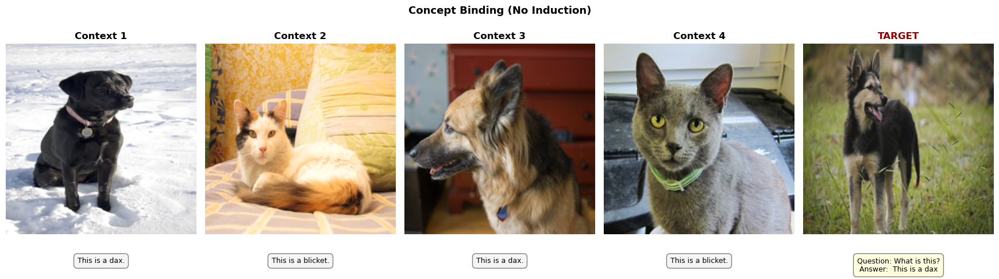

In [11]:
# ============================================================================
# TEST 4B: FAST CONCEPT BINDING - WITHOUT TASK INDUCTION (Ablation)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 4B: FAST CONCEPT BINDING (Without Task Induction - Ablation)")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE (Same as above)
img_dax_1 = load_img("dog_1")
img_blk_1 = load_img("cat_1")
img_dax_2 = load_img("dog_2")
img_blk_2 = load_img("cat_2")
target_image = load_img("dog_4")

if all([img_dax_1, img_blk_1, img_dax_2, img_blk_2, target_image]):
    prompt = [
        # ❌ NO Task induction
        img_dax_1, "This is a dax.\n",
        img_blk_1, "This is a blicket.\n",
        img_dax_2, "This is a dax.\n",
        img_blk_2, "This is a blicket.\n",
        target_image, "Question: What is this?\nAnswer:"
    ]
    
    answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
    
    print(f"Query: What is this? (No induction)")
    print(f"Answer: {answer}")
    
    visualize_result(prompt, answer, "Concept Binding (No Induction)")
else:
    print("⚠️  Skipped: Required images not found")


TEST 5: FAST-VQA
Query: What color is the dax?
Answer: It is a black and white cat .



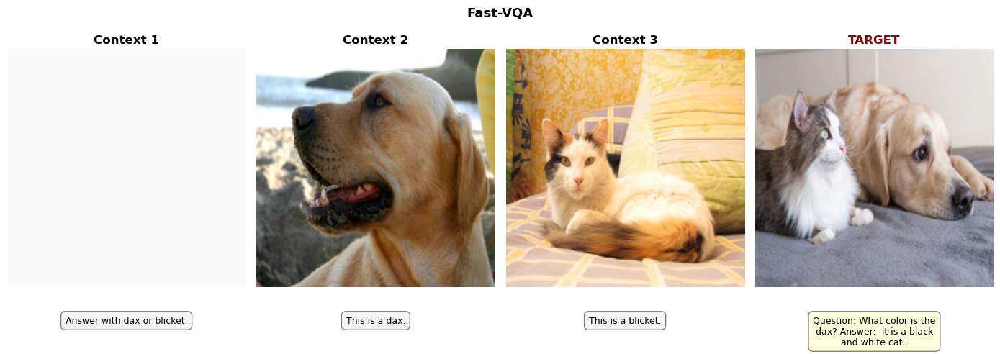

In [12]:
# ============================================================================
# TEST 5: FAST-VQA (Section 4.4.5)
# ============================================================================
print("\n" + "=" * 70)
print("TEST 5: FAST-VQA")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE
img_dax = load_img("dog_3")       # Teach: Dog is dax
img_blk = load_img("cat_1")       # Teach: Cat is blicket
target_image = load_img("cat_dog") # Scene with both (or similar)

if all([img_dax, img_blk, target_image]):
    prompt = [
        "Answer with dax or blicket.\n",
        img_dax, "This is a dax.\n",
        img_blk, "This is a blicket.\n",
        
        # Ask reasoning question
        target_image, "Question: What color is the dax?\nAnswer:"
    ]
    
    answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=8)
    
    print(f"Query: What color is the dax?")
    print(f"Answer: {answer}\n")
    
    visualize_result(prompt, answer, "Fast-VQA")
else:
    print("⚠️  Skipped: Required images not found")


ABLATION STUDY: EFFECT OF REPETITION
  Repeats=0 (Total shown=1): dog that is a mix


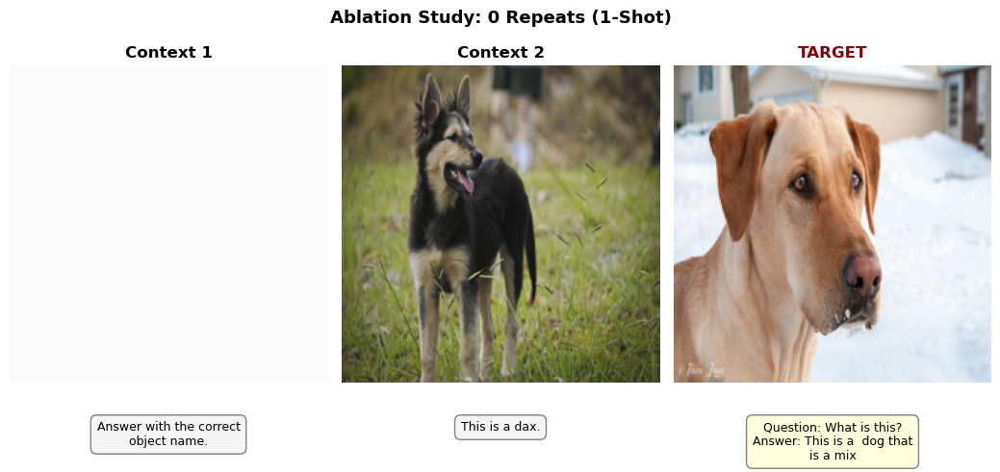

  Repeats=1 (Total shown=2): dax.


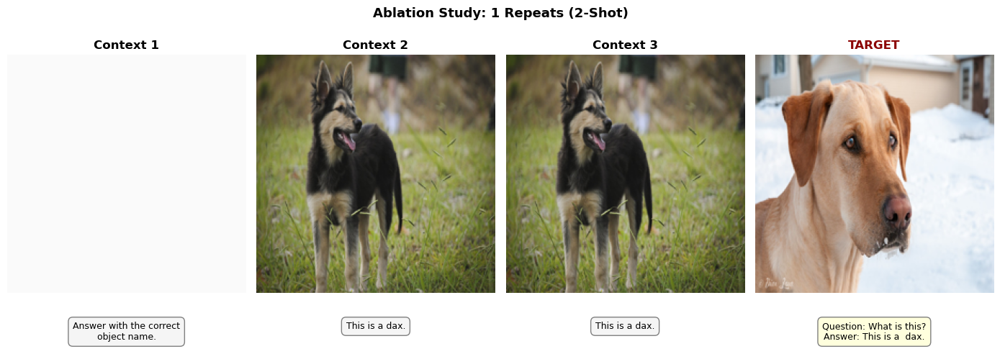

  Repeats=3 (Total shown=4): dax.


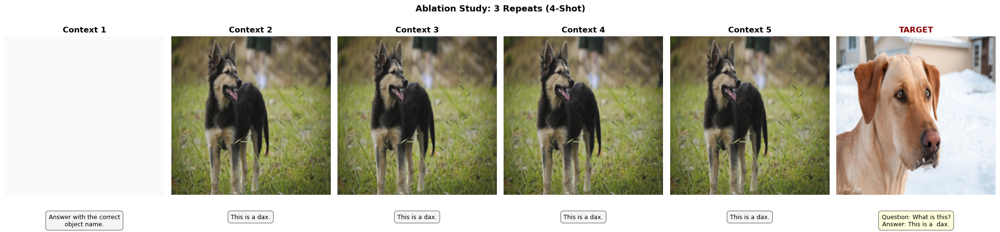

  Repeats=5 (Total shown=6): dax.


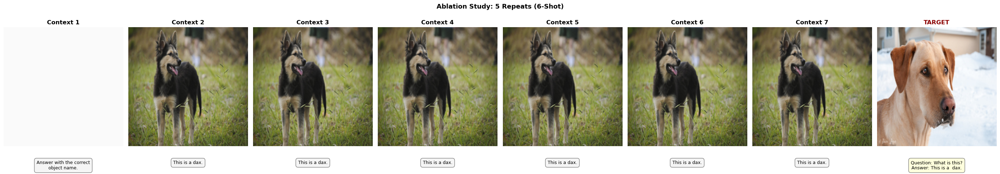

In [13]:
# ============================================================================
# ABLATION STUDY: EFFECT OF REPETITION (Paper Table 3)
# ============================================================================
print("\n" + "=" * 70)
print("ABLATION STUDY: EFFECT OF REPETITION")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE
support_img = load_img("dog_4")   # Image to repeat
query_img   = load_img("dog_5")   # Target image

def test_repeats(support_img, support_name, query_img, repeats_list=[0, 1, 3, 5]):
    results = {}
    if not support_img or not query_img:
        return results

    for r in repeats_list:
        prompt = ["Answer with the correct object name.\n"]
        # Repeat the same example (r+1) times total
        for _ in range(r + 1):
            prompt.extend([support_img, f"This is a {support_name}.\n"])
        
        # Add query
        prompt.extend([query_img, "Question: What is this?\nAnswer: This is a"])
        
        # Generate answer
        ans = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
        results[r] = ans
        print(f"  Repeats={r} (Total shown={r+1}): {ans}")

        # 🟢 ADDED VISUALIZATION STEP HERE
        # This will generate an image for every step in the loop
        title = f"Ablation Study: {r} Repeats ({r+1}-Shot)"
        visualize_result(prompt, ans, title)
        
    return results

if support_img and query_img:
    # Running with fewer repeats first to test visualization
    test_repeats(support_img, "dax", query_img, repeats_list=[0, 1, 3, 5])
else:
    print("⚠️  Skipped: Required images not found")


ABLATION STUDY: EFFECT OF REPETITION
  Repeats=0 (Total shown=1): cat .


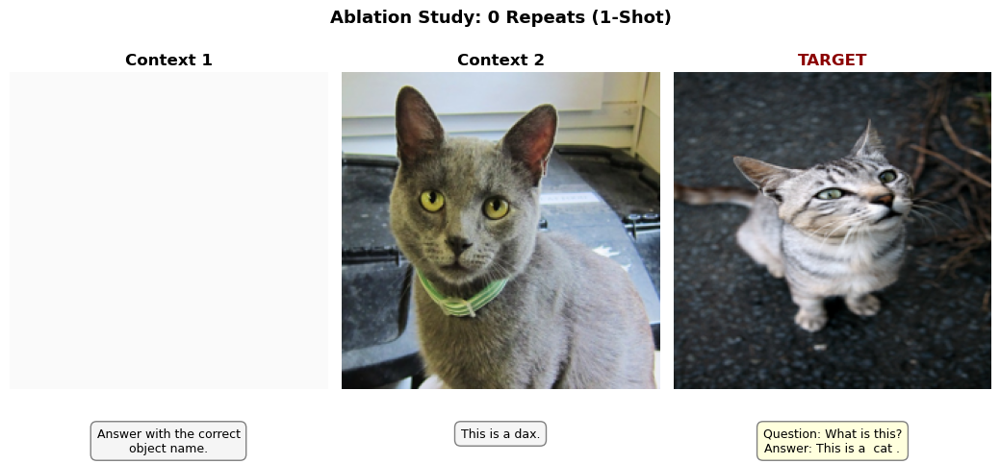

  Repeats=1 (Total shown=2): dax.


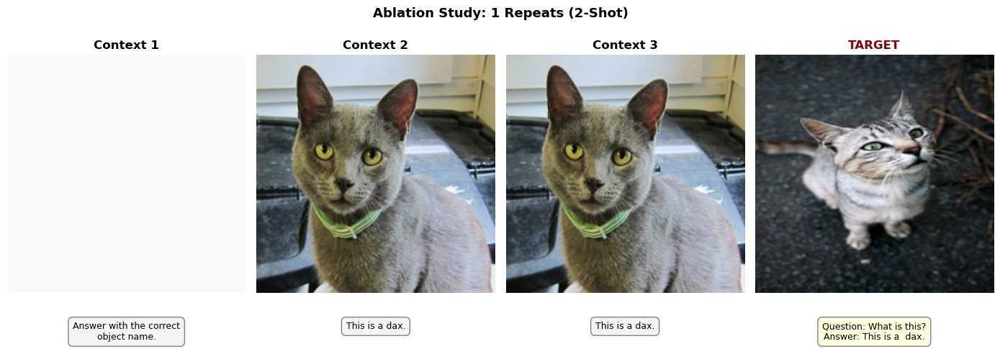

  Repeats=3 (Total shown=4): dax.


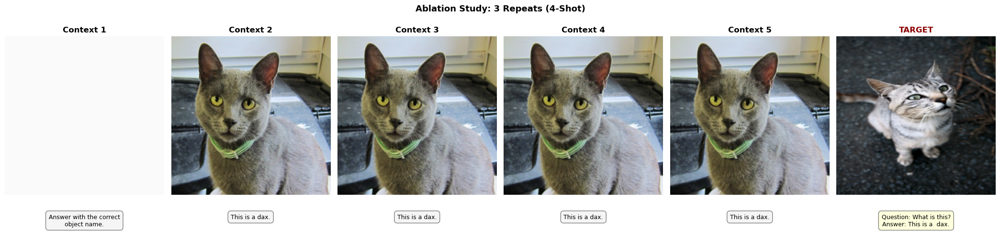

  Repeats=5 (Total shown=6): dax.


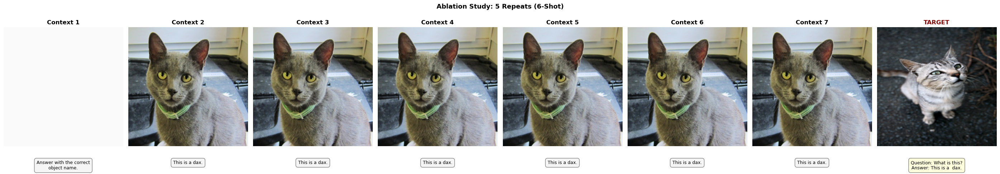

In [14]:
# ============================================================================
# ABLATION STUDY: EFFECT OF REPETITION (Paper Table 3)
# ============================================================================
print("\n" + "=" * 70)
print("ABLATION STUDY: EFFECT OF REPETITION")
print("=" * 70)

# 🟢 UPDATE IMAGES HERE
support_img = load_img("cat_2")   # Image to repeat
query_img   = load_img("cat_4")   # Target image

def test_repeats(support_img, support_name, query_img, repeats_list=[0, 1, 3, 5]):
    results = {}
    if not support_img or not query_img:
        return results

    for r in repeats_list:
        prompt = ["Answer with the correct object name.\n"]
        # Repeat the same example (r+1) times total
        for _ in range(r + 1):
            prompt.extend([support_img, f"This is a {support_name}.\n"])
        
        # Add query
        prompt.extend([query_img, "Question: What is this?\nAnswer: This is a"])
        
        # Generate answer
        ans = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
        results[r] = ans
        print(f"  Repeats={r} (Total shown={r+1}): {ans}")

        # 🟢 ADDED VISUALIZATION STEP HERE
        # This will generate an image for every step in the loop
        title = f"Ablation Study: {r} Repeats ({r+1}-Shot)"
        visualize_result(prompt, ans, title)
        
    return results

if support_img and query_img:
    # Running with fewer repeats first to test visualization
    test_repeats(support_img, "dax", query_img, repeats_list=[0, 1, 3, 5])
else:
    print("⚠️  Skipped: Required images not found")

# GENERATING RESULTS FOR THE PAPER

In [15]:
# ============================================================================
# ADDITIONAL ZERO-SHOT VQA TESTS
# ============================================================================
print("\n" + "=" * 70)
print("ADDITIONAL ZERO-SHOT VQA TESTS")
print("=" * 70)


ADDITIONAL ZERO-SHOT VQA TESTS


Query: How many cats are in the image?
Answer: There are two cats in the image.



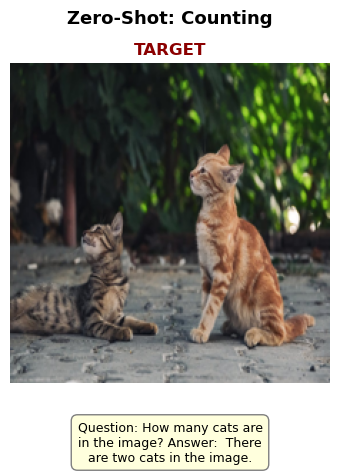

In [16]:
# ----------------------------------------------------------------------------
# 1. COUNTING TEST
# ----------------------------------------------------------------------------
target_img_count = load_img("cat_6")  # 📸 Update: Image with multiple cats

if target_img_count:
    prompt = [
        target_img_count, 
        "Question: How many cats are in the image?\nAnswer:" 
    ]
    
    answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=8)
    print(f"Query: How many cats are in the image?")
    print(f"Answer: {answer}\n")
    
    visualize_result(prompt, answer, "Zero-Shot: Counting")
else:
    print("⚠️  Skipped: Counting image not found")

🖼️  Testing multiple prompts on image...

🔹 Strategy: Standard VQA
   Output:   cat .
--------------------------------------------------


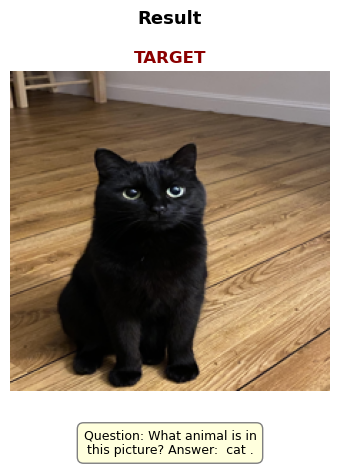

🔹 Strategy: Primed Answer
   Output:   cat . It is a black and white cat with
--------------------------------------------------


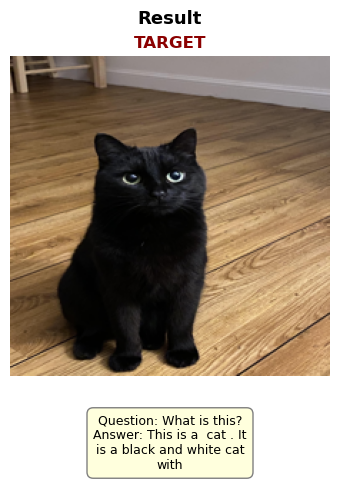

🔹 Strategy: Caption Completion
   Output:   cat with a black and white striped coat . person
--------------------------------------------------


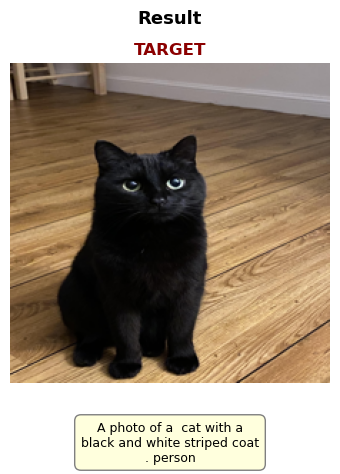

🔹 Strategy: Action Question
   Output:   It is sitting on the floor . . . .
--------------------------------------------------


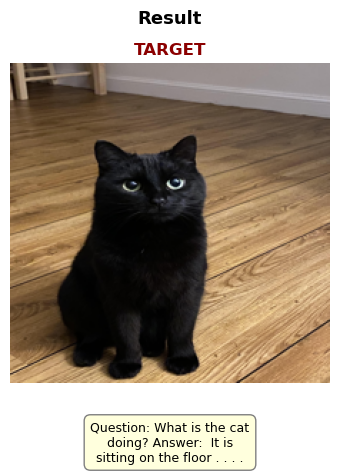

🔹 Strategy: Detail Extraction
   Output:   black .
--------------------------------------------------


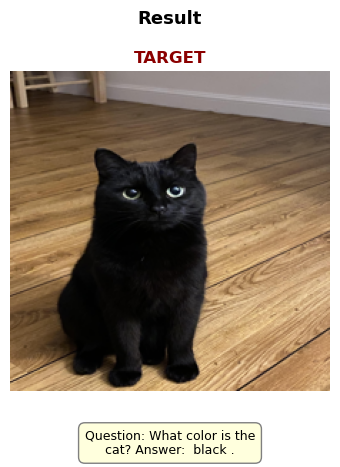

In [17]:

# ============================================================================
# MULTI-PROMPT EVALUATION FOR CAT IMAGE
# ============================================================================

# 📸 Update this to your specific cat image
target_img = load_img("cat_7") 

if target_img:
    print(f"🖼️  Testing multiple prompts on image...\n")
    
    # List of different prompt strategies
    prompt_variations = [
        # 1. Standard VQA
        ("Standard VQA", [target_img, "Question: What animal is in this picture?\nAnswer:"]),
        
        # 2. Primed Answer (Forces the model to start with 'This is')
        ("Primed Answer", [target_img, "Question: What is this?\nAnswer: This is a"]),
        
        # 3. Caption Completion (Works well for GPT-2)
        ("Caption Completion", [target_img, "A photo of a"]),
        
        # 4. Action/State Question
        ("Action Question", [target_img, "Question: What is the cat doing?\nAnswer:"]),
        
        # 5. Detail Extraction
        ("Detail Extraction", [target_img, "Question: What color is the cat?\nAnswer:"])
    ]

    for style_name, prompt_content in prompt_variations:
        # Generate
        response = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=10)
        
        # Formatting for readability
        clean_response = response.replace("\n", " ")
        print(f"🔹 Strategy: {style_name}")
        print(f"   Output:   {clean_response}")
        print("-" * 50)
        visualize_result(prompt_content, response)
        
else:
    print("⚠️ Image not found.")

🎨 Testing color detection strategies...



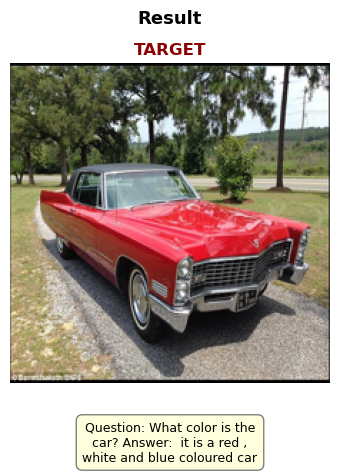

🔹 [Standard VQA]
   Prompt: "Question: What color is the car?
Answer:"
   Model output: "it is a red , white and blue coloured car"
--------------------------------------------------


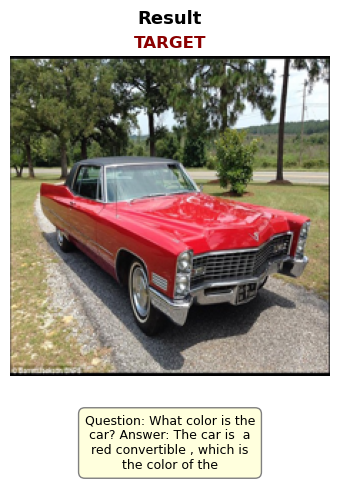

🔹 [Primed Sentence]
   Prompt: "Question: What color is the car?
Answer: The car is"
   Model output: "a red convertible , which is the color of the"
--------------------------------------------------


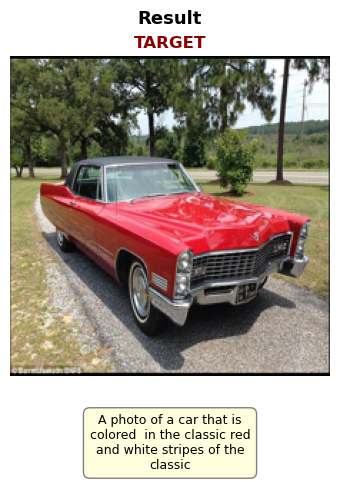

🔹 [Fill-in-blank]
   Prompt: "A photo of a car that is colored"
   Model output: "in the classic red and white stripes of the classic"
--------------------------------------------------


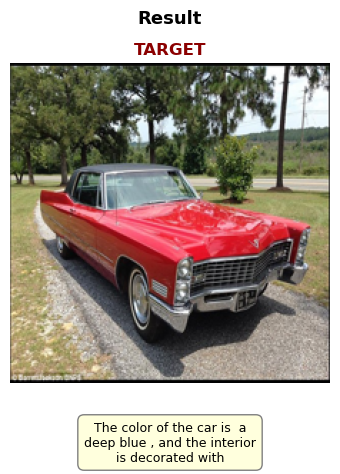

🔹 [Short Caption]
   Prompt: "The color of the car is"
   Model output: "a deep blue , and the interior is decorated with"
--------------------------------------------------


In [18]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT COLOR EVALUATION
# ----------------------------------------------------------------------------
target_img = load_img("red_car")

if target_img:
    print(f"🎨 Testing color detection strategies...\n")
    
    # We define different ways to ask the same thing
    variations = [
        # 1. Standard VQA (Often used in papers)
        ("Standard VQA", "Question: What color is the car?\nAnswer:"),
        
        # 2. Primed Sentence (Usually the most accurate for Frozen models)
        ("Primed Sentence", "Question: What color is the car?\nAnswer: The car is"),
        
        # 3. Fill-in-the-blank (Short and direct)
        ("Fill-in-blank", "A photo of a car that is colored"),
        
        # 4. Short Captioning (Tests if the model can describe without a question)
        ("Short Caption", "The color of the car is")
    ]

    for style_name, text_prompt in variations:
        prompt = [target_img, text_prompt]
        
        # Generate answer
        # Note: We use a small max_new_tokens for color (1-3 tokens)
        answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=10)
        visualize_result(prompt, answer)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{answer}\"")
        print("-" * 50)
else:
    print("⚠️  Skipped: Image 'red_car' not found")

🏔️ Testing location/scene reasoning strategies...

🔹 [Direct VQA]
   Prompt: "Question: Where is this picture taken?
Answer:"
   Model output: "it is taken at the top of a mountain in the middle of the lake ."


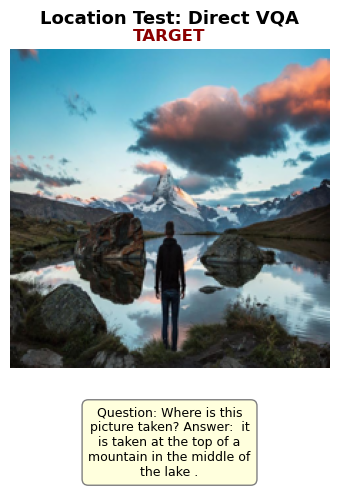

--------------------------------------------------
🔹 [Primed Location]
   Prompt: "Question: Where is this picture taken?
Answer: It was taken in the"
   Model output: "mountains of the north ."


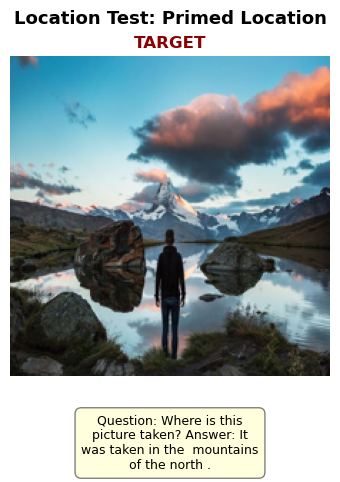

--------------------------------------------------
🔹 [Scene Description]
   Prompt: "The setting of this image is"
   Model output: "a lake in the mountains . . . the lake is surrounded by a forest . . . the forest"


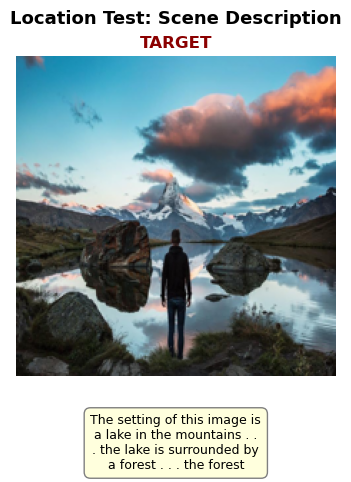

--------------------------------------------------
🔹 [Background Focus]
   Prompt: "Question: What is in the background of this photo?
Answer:"
   Model output: "a man and a woman standing on a cliff ."


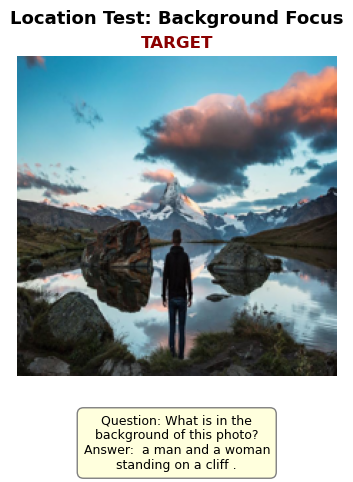

--------------------------------------------------


In [19]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT LOCATION / SCENE EVALUATION
# ----------------------------------------------------------------------------
target_img_loc = load_img("person_on_mountains")

if target_img_loc:
    print(f"🏔️ Testing location/scene reasoning strategies...\n")
    
    # We define different ways to extract the scene/location
    variations = [
        # 1. Direct Location Question
        ("Direct VQA", "Question: Where is this picture taken?\nAnswer:"),
        
        # 2. Primed Location (Forces a geographical/setting answer)
        ("Primed Location", "Question: Where is this picture taken?\nAnswer: It was taken in the"),
        
        # 3. Descriptive Context (Encourages scene understanding)
        ("Scene Description", "The setting of this image is"),
        
        # 4. Background Focus (Helps if there's a subject in the way)
        ("Background Focus", "Question: What is in the background of this photo?\nAnswer:")
    ]

    for style_name, text_prompt in variations:
        prompt = [target_img_loc, text_prompt]
        
        # Generate answer - we use more tokens for location as it might be a phrase
        answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=20)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{answer}\"")
        
        # Keep the visualization for every attempt as requested
        visualize_result(prompt, answer, f"Location Test: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Location image 'person_on_mountains' not found")

🐕/🐈 Testing classification strategies...

🔹 [Standard Choice]
   Prompt: "Question: Is this a cat or a dog?
Answer:"
   Model output: "This is a dog."


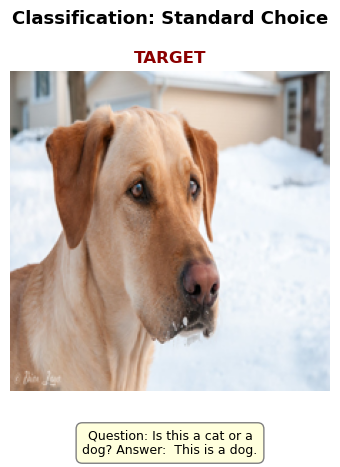

--------------------------------------------------
🔹 [Forced ID]
   Prompt: "Question: What kind of animal is this?
Answer: This is a"
   Model output: "dog ."


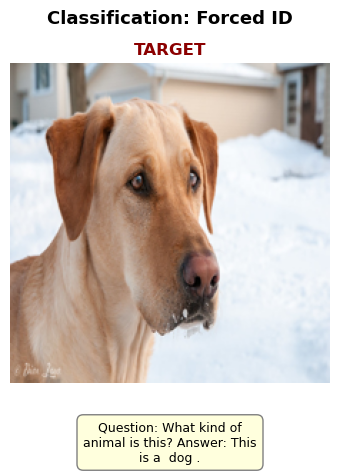

--------------------------------------------------
🔹 [Task Induction]
   Prompt: "Answer with only the word 'cat' or 'dog'.
Question: Is this a cat or a dog?
Answer:"
   Model output: "This is a cat."


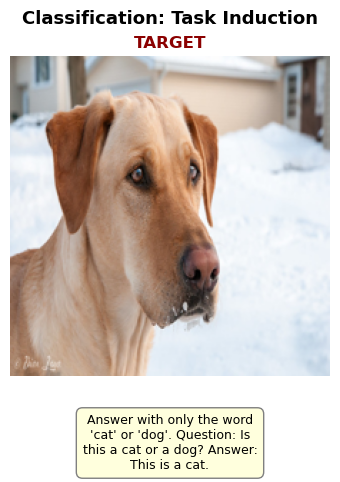

--------------------------------------------------
🔹 [Leading Sentence]
   Prompt: "A photograph of a pet"
   Model output: "dog in the snow ."


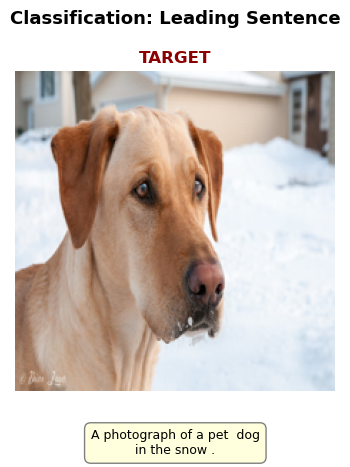

--------------------------------------------------


In [20]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT BINARY CLASSIFICATION (Cat vs Dog)
# ----------------------------------------------------------------------------
target_img_cls = load_img("dog_5")

if target_img_cls:
    print(f"🐕/🐈 Testing classification strategies...\n")
    
    # Different ways to force a choice between two labels
    variations = [
        # 1. Standard Choice (The model often repeats both or goes off-topic)
        ("Standard Choice", "Question: Is this a cat or a dog?\nAnswer:"),
        
        # 2. Forced Identification (Usually very effective)
        ("Forced ID", "Question: What kind of animal is this?\nAnswer: This is a"),
        
        # 3. Task Induction (Tells the model the rules first)
        ("Task Induction", "Answer with only the word 'cat' or 'dog'.\nQuestion: Is this a cat or a dog?\nAnswer:"),
        
        # 4. Leading Sentence (High success rate for frozen LLMs)
        ("Leading Sentence", "A photograph of a pet")
    ]

    for style_name, text_prompt in variations:
        prompt = [target_img_cls, text_prompt]
        
        # We only need 1-2 tokens for the label
        answer = generate_interleaved(model, tokenizer, prompt, max_new_tokens=10)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{answer}\"")
        
        # Use your visualization helper
        visualize_result(prompt, answer, f"Classification: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Classification image 'dog_5' not found")

🍴 Testing action recognition strategies...

🔹 [Standard VQA]
   Prompt: "Question: What is the person doing?
Answer:"
   Model output: "Eating a burger ."


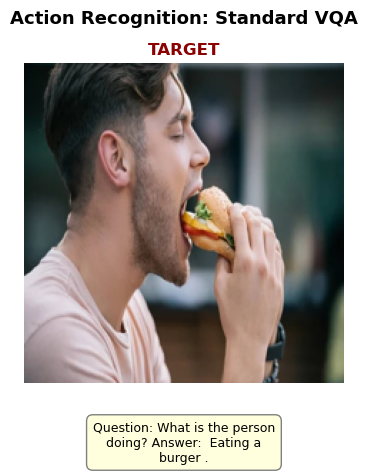

--------------------------------------------------
🔹 [Primed Verb]
   Prompt: "Question: What is the person doing?
Answer: The person is"
   Model output: "eating a burger ."


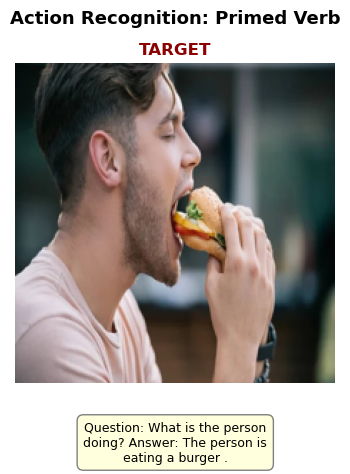

--------------------------------------------------
🔹 [Caption Completion]
   Prompt: "A photo of a person who is"
   Model output: "eating a burger in a"


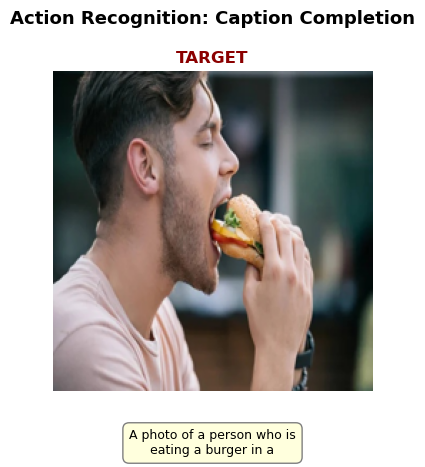

--------------------------------------------------
🔹 [Interaction Focus]
   Prompt: "Question: What is the person holding?
Answer:"
   Model output: "a burger , fries ,"


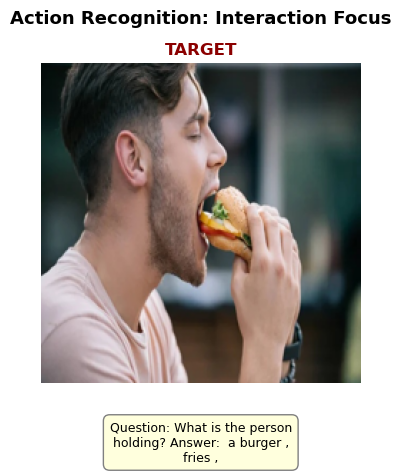

--------------------------------------------------


In [21]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ACTION RECOGNITION EVALUATION
# ----------------------------------------------------------------------------
key = "person_eating" 
img = load_img(key)

if img:
    print(f"🍴 Testing action recognition strategies...\n")
    
    # Variations to test different "Frozen" behaviors
    variations = [
        # 1. Standard VQA
        ("Standard VQA", "Question: What is the person doing?\nAnswer:"),
        
        # 2. Primed Verb (Forces a present continuous '-ing' answer)
        ("Primed Verb", "Question: What is the person doing?\nAnswer: The person is"),
        
        # 3. Caption Completion (Direct and often more descriptive)
        ("Caption Completion", "A photo of a person who is"),
        
        # 4. Object Interaction Focus
        ("Interaction Focus", "Question: What is the person holding?\nAnswer:")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Actions usually need 3-5 tokens (e.g., "eating an apple")
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Using the requested visualize_result function
        visualize_result(prompt, output, f"Action Recognition: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")

✈️ Testing object and color recognition strategies...

🔹 [Color VQA]
   Prompt: "Question: What color is the plane?
Answer:"
   Model output: "it is a white plane"


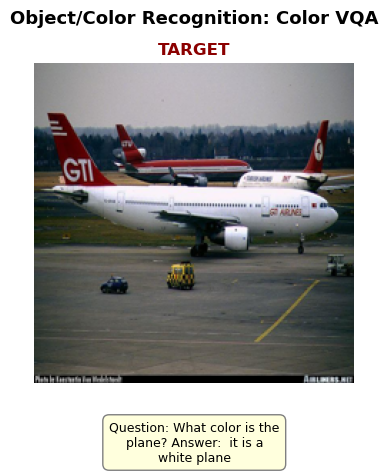

--------------------------------------------------
🔹 [Primed Color]
   Prompt: "Question: What color is the plane?
Answer: The plane is"
   Model output: "white ."


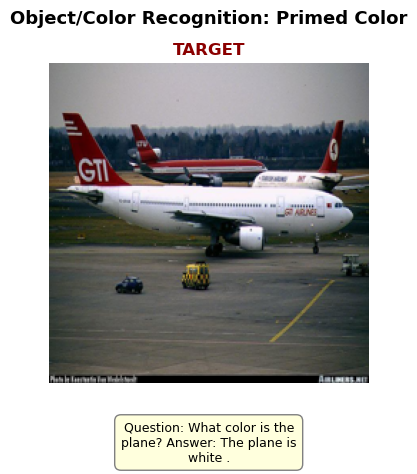

--------------------------------------------------
🔹 [Object ID]
   Prompt: "Question: What is this an image of?
Answer: This is a"
   Model output: "picture of the airport ."


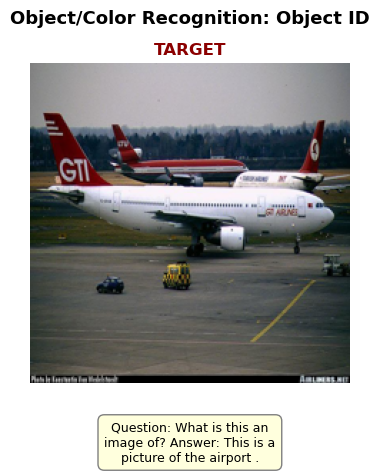

--------------------------------------------------
🔹 [Descriptive]
   Prompt: "A photo of a"
   Model output: "plane on the runway ."


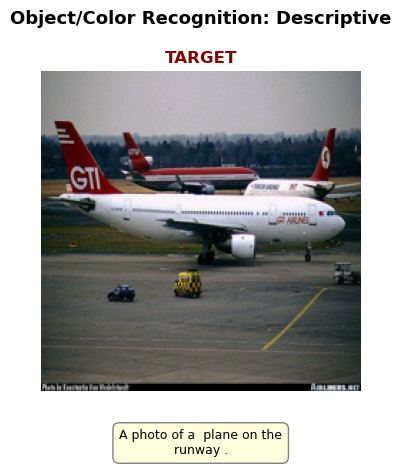

--------------------------------------------------


In [22]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT OBJECT & ATTRIBUTE EVALUATION
# ----------------------------------------------------------------------------
key = "plane_4" 
img = load_img(key)

if img:
    print(f"✈️ Testing object and color recognition strategies...\n")
    
    # Variations to test if the model recognizes the object vs. just the color
    variations = [
        # 1. Attribute VQA (Your original case)
        ("Color VQA", "Question: What color is the plane?\nAnswer:"),
        
        # 2. Primed Attribute (Most reliable for specific details)
        ("Primed Color", "Question: What color is the plane?\nAnswer: The plane is"),
        
        # 3. Object Identification (Sanity check: does it know it's a plane?)
        ("Object ID", "Question: What is this an image of?\nAnswer: This is a"),
        
        # 4. Combined Descriptive Prompt
        ("Descriptive", "A photo of a")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Using the fixed generate_interleaved function from our previous steps
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Using the visualize_result function to keep consistency
        visualize_result(prompt, output, f"Object/Color Recognition: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")

🌲 Testing object recognition strategies...

🔹 [Direct VQA]
   Prompt: "Question: What is this object?
Answer:"
   Model output: "a christmas tree ."


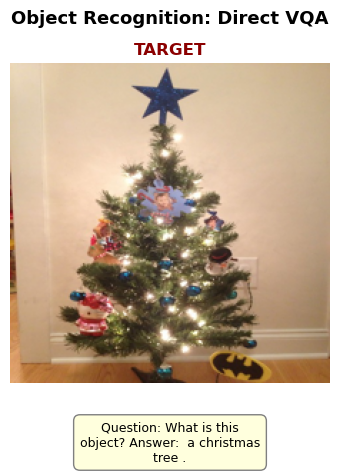

--------------------------------------------------
🔹 [Primed ID]
   Prompt: "Question: What is this?
Answer: This is a"
   Model output: "christmas tree . ."


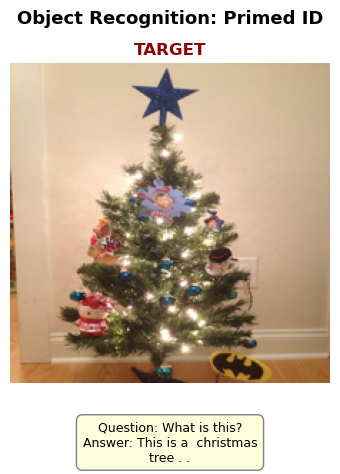

--------------------------------------------------
🔹 [Specific ID]
   Prompt: "Question: What kind of tree is this?
Answer:"
   Model output: "This is a christmas"


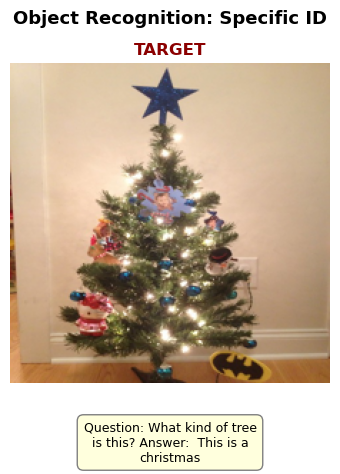

--------------------------------------------------
🔹 [Captioning]
   Prompt: "A close-up photo of a"
   Model output: "christmas tree . ."


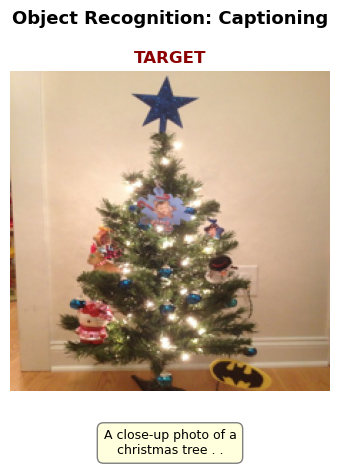

--------------------------------------------------


In [23]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT OBJECT RECOGNITION (Tree)
# ----------------------------------------------------------------------------
key = "tree" 
img = load_img(key)

if img:
    print(f"🌲 Testing object recognition strategies...\n")
    
    # Testing different linguistic "angles" for the same image
    variations = [
        # 1. Direct Identification (The most common test)
        ("Direct VQA", "Question: What is this object?\nAnswer:"),
        
        # 2. Primed Identification (Strongest for Frozen models)
        ("Primed ID", "Question: What is this?\nAnswer: This is a"),
        
        # 3. Species/Type Query (Checks for granular knowledge)
        ("Specific ID", "Question: What kind of tree is this?\nAnswer:"),
        
        # 4. Zero-Shot Captioning
        ("Captioning", "A close-up photo of a")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # We use the generate_interleaved function we fixed earlier
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Keeping your visualization style
        visualize_result(prompt, output, f"Object Recognition: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")

🐎 Testing animal recognition strategies...

🔹 [Standard VQA]
   Prompt: "Question: What animal is this?
Answer:"
   Model output: "horse ."


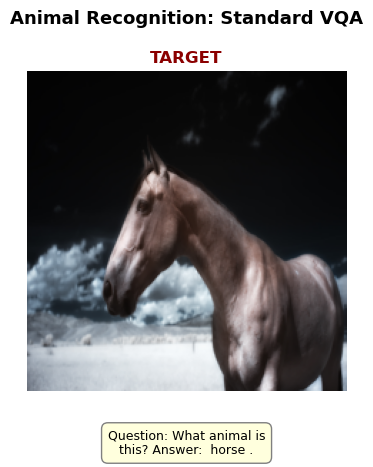

--------------------------------------------------
🔹 [Primed ID]
   Prompt: "Question: What is this?
Answer: This is a"
   Model output: "horse ."


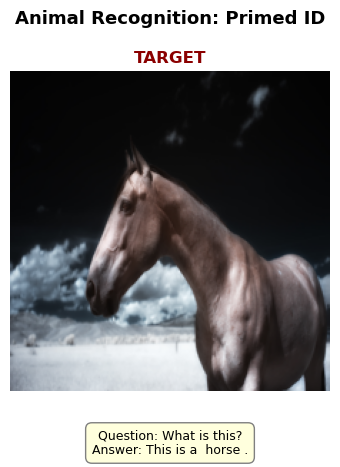

--------------------------------------------------
🔹 [Caption Completion]
   Prompt: "A photo of a"
   Model output: "horse with a white mane"


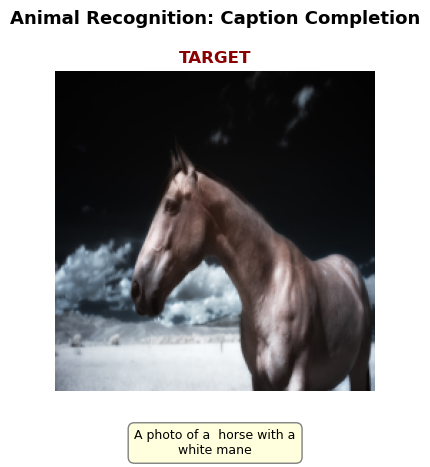

--------------------------------------------------
🔹 [Contextual]
   Prompt: "Question: What is in the field?
Answer:"
   Model output: "Horses ."


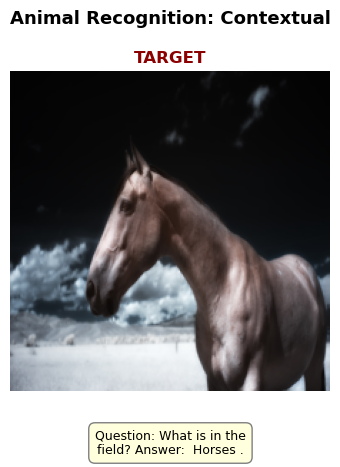

--------------------------------------------------


In [24]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT OBJECT RECOGNITION (Horse)
# ----------------------------------------------------------------------------
key = "horse_1" 
img = load_img(key)

if img:
    print(f"🐎 Testing animal recognition strategies...\n")
    
    # Testing different ways the Frozen LM might "complete" the concept
    variations = [
        # 1. Standard VQA (Your original case)
        ("Standard VQA", "Question: What animal is this?\nAnswer:"),
        
        # 2. Primed Identification (Forces a noun response)
        ("Primed ID", "Question: What is this?\nAnswer: This is a"),
        
        # 3. Descriptive Context (Uses the LM's captioning strengths)
        ("Caption Completion", "A photo of a"),
        
        # 4. Action/Contextual Query (Helps if the background is strong)
        ("Contextual", "Question: What is in the field?\nAnswer:")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Use the generate_interleaved function we fixed earlier
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=6)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Using the requested visualize_result style for consistency
        visualize_result(prompt, output, f"Animal Recognition: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")

😊 Testing emotion recognition strategies...

🔹 [Direct VQA]
   Prompt: "Question: What emotion is the person showing?
Answer:"
   Model output: "A smile."


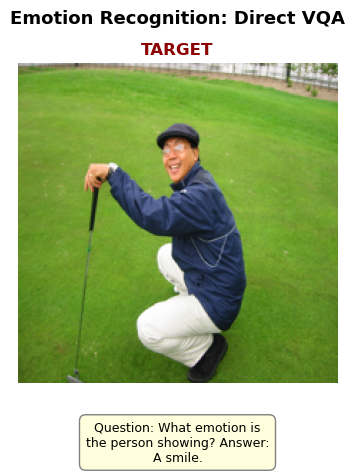

--------------------------------------------------
🔹 [Primed State]
   Prompt: "Question: How does the person feel?
Answer: The person feels"
   Model output: "good."


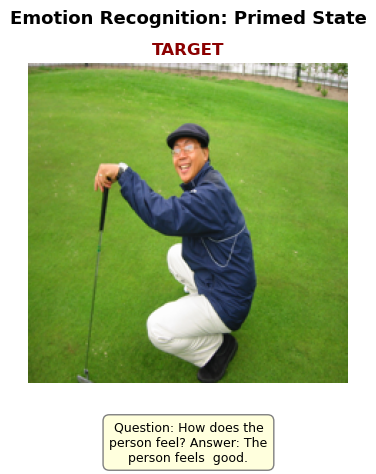

--------------------------------------------------
🔹 [Feature Focus]
   Prompt: "The person in the photo has a big smile on their face because they are"
   Model output: "the first person to win the tournament ."


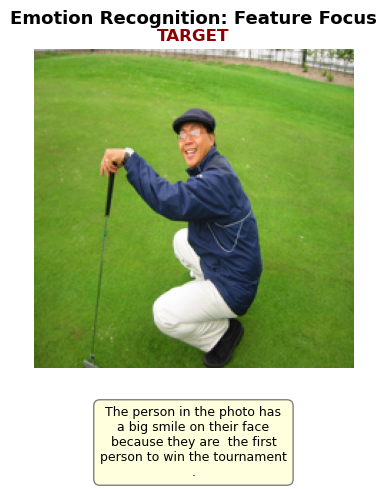

--------------------------------------------------
🔹 [Captioning]
   Prompt: "A photo of a person who looks"
   Model output: "like he's about to play golf ."


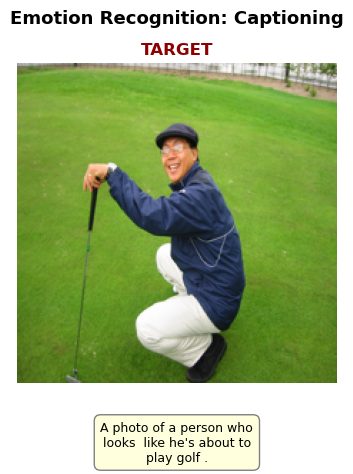

--------------------------------------------------


In [25]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT EMOTION RECOGNITION (Happy)
# ----------------------------------------------------------------------------
key = "person_happy" 
img = load_img(key)

if img:
    print(f"😊 Testing emotion recognition strategies...\n")
    
    # Testing how the model connects facial features to emotional labels
    variations = [
        # 1. Direct Emotion VQA (Your original case)
        ("Direct VQA", "Question: What emotion is the person showing?\nAnswer:"),
        
        # 2. Primed State (Forces an adjective response)
        ("Primed State", "Question: How does the person feel?\nAnswer: The person feels"),
        
        # 3. Facial Feature Focus (Eases the model into the conclusion)
        ("Feature Focus", "The person in the photo has a big smile on their face because they are"),
        
        # 4. Simple Captioning
        ("Captioning", "A photo of a person who looks")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Using the generate_interleaved function with the fixes from previous steps
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=15)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Keeping your visualization style
        visualize_result(prompt, output, f"Emotion Recognition: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")


## 4. Test Case: Rapid Task Adaptation (Few-Shot VQA)
**Capability:** Evaluation of whether providing examples (shots) improves the model's response.
**Prompt Structure:** `[Img1] Q:.. A: Dog. [Img2] Q:.. A: Plane. [TargetImg] Q:.. A:`


🦁 Testing few-shot adaptation for Lion recognition...

🔹 [Standard Few-Shot]
   Model output: "dog ."


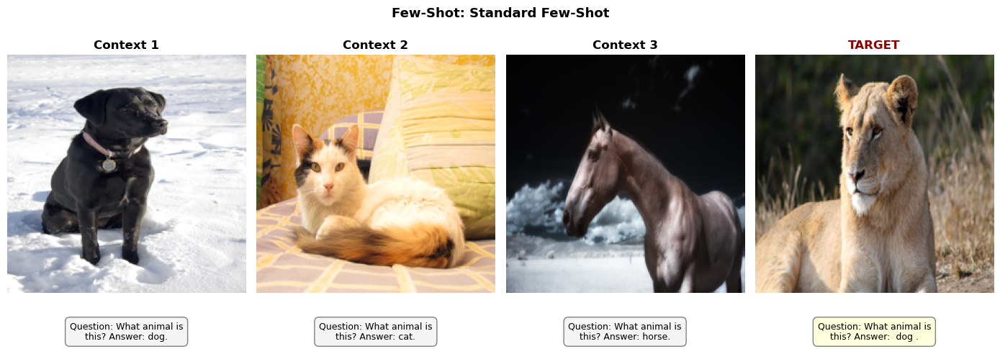

--------------------------------------------------
🔹 [Caption Few-Shot]
   Model output: "dog."


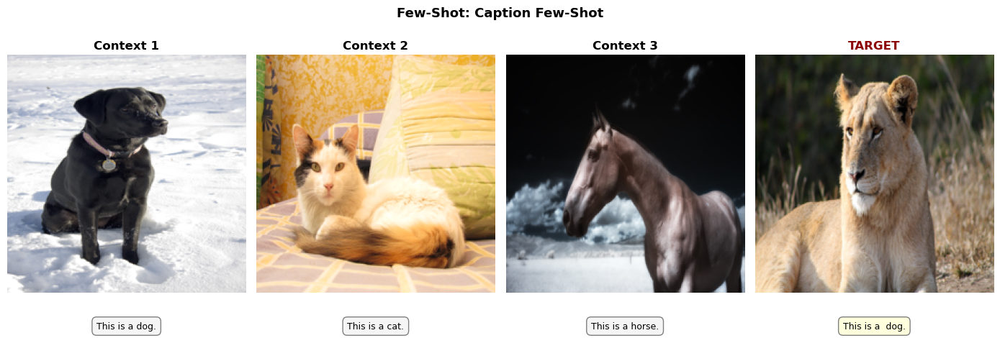

--------------------------------------------------
🔹 [Minimalist Induction]
   Model output: "lions"


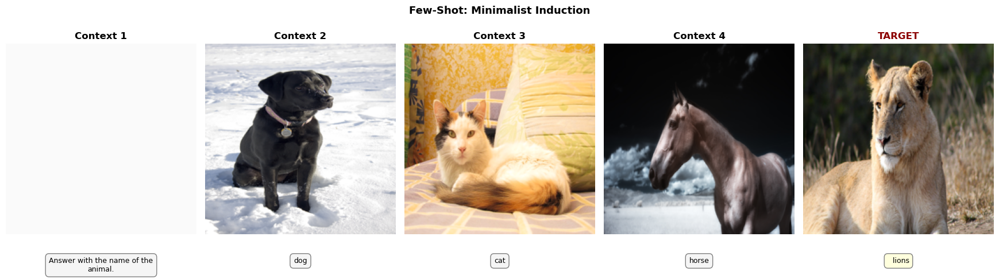

--------------------------------------------------


In [26]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT FEW-SHOT ADAPTATION (Rapid Learning)
# ----------------------------------------------------------------------------
img_s1 = load_img("dog_1")
img_s2 = load_img("cat_1")
img_s3 = load_img("horse_1")
img_t  = load_img("lion_1") 

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🦁 Testing few-shot adaptation for Lion recognition...\n")
    
    # Strategy 1: Your original Few-Shot pattern (Cleaned)
    prompt_few_shot = [
        img_s1, "Question: What animal is this?\nAnswer: dog.\n",
        img_s2, "Question: What animal is this?\nAnswer: cat.\n",
        img_s3, "Question: What animal is this?\nAnswer: horse.\n",
        img_t,  "Question: What animal is this?\nAnswer:"
    ]

    # Strategy 2: Caption-style Few-Shot (Often smoother for GPT-2)
    prompt_caption_shot = [
        img_s1, "This is a dog.\n",
        img_s2, "This is a cat.\n",
        img_s3, "This is a horse.\n",
        img_t,  "This is a"
    ]

    # Strategy 3: Task Induction + Few-Shot
    prompt_induction = [
        "Answer with the name of the animal.\n",
        img_s1, "dog\n",
        img_s2, "cat\n",
        img_s3, "horse\n",
        img_t,  "" # Pure completion
    ]

    test_cases = [
        ("Standard Few-Shot", prompt_few_shot),
        ("Caption Few-Shot", prompt_caption_shot),
        ("Minimalist Induction", prompt_induction)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - Few-shot usually needs very few tokens (1-2)
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=2)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Visualize the full context and final prediction
        visualize_result(prompt_content, output, f"Few-Shot: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: One or more images for the few-shot test are missing.")

🚌 Testing few-shot color adaptation...

🔹 [Standard Few-Shot]
   Model output: "What color"


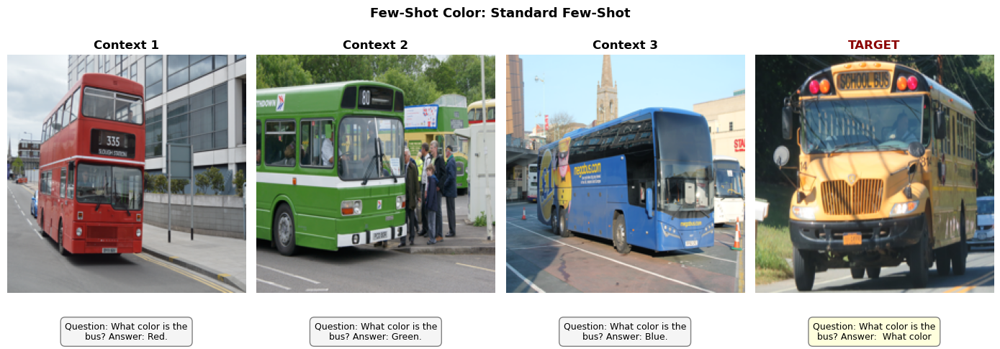

--------------------------------------------------
🔹 [Descriptive Completion]
   Model output: "red bus"


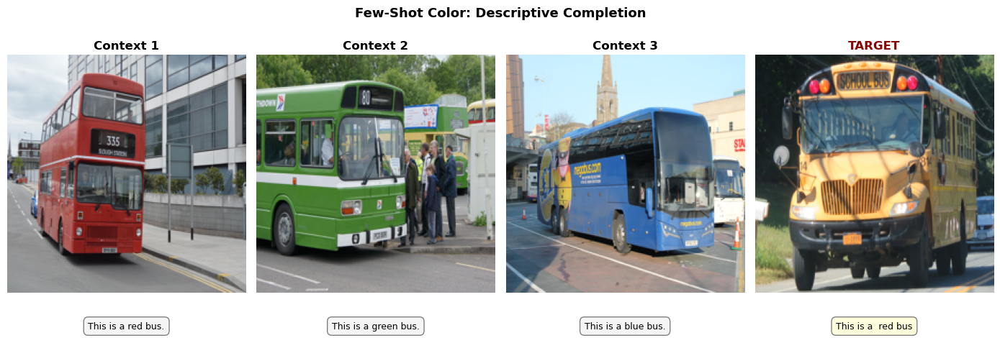

--------------------------------------------------
🔹 [Minimalist Pattern]
   Model output: "a school"


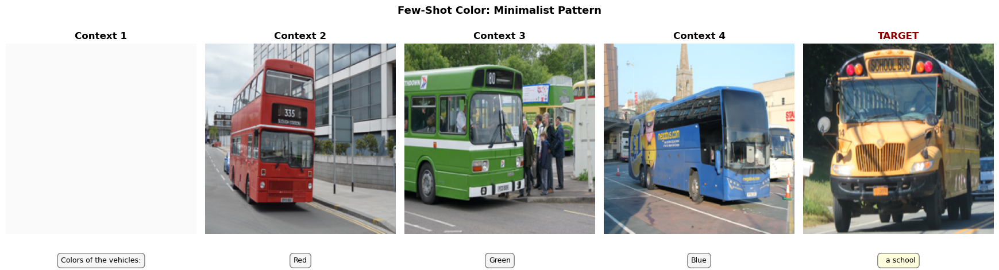

--------------------------------------------------


In [27]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT FEW-SHOT COLOR ADAPTATION
# ----------------------------------------------------------------------------
img_s1 = load_img("bus_2")
img_s2 = load_img("bus_3")
img_s3 = load_img("bus_4")
img_t  = load_img("bus_1") 

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🚌 Testing few-shot color adaptation...\n")
    
    # Strategy 1: Standard Few-Shot (Your original logic)
    # Good for teaching the Q&A format.
    prompt_standard = [
        img_s1, "Question: What color is the bus?\nAnswer: Red.\n",
        img_s2, "Question: What color is the bus?\nAnswer: Green.\n",
        img_s3, "Question: What color is the bus?\nAnswer: Blue.\n",
        img_t,  "Question: What color is the bus?\nAnswer:"
    ]

    # Strategy 2: Descriptive Few-Shot (Prefix completion)
    # Usually has the highest success rate in Frozen models.
    prompt_desc = [
        img_s1, "This is a red bus.\n",
        img_s2, "This is a green bus.\n",
        img_s3, "This is a blue bus.\n",
        img_t,  "This is a"
    ]

    # Strategy 3: Minimalist List (Pure pattern matching)
    prompt_list = [
        "Colors of the vehicles:\n",
        img_s1, "Red\n",
        img_s2, "Green\n",
        img_s3, "Blue\n",
        img_t,  ""
    ]

    test_cases = [
        ("Standard Few-Shot", prompt_standard),
        ("Descriptive Completion", prompt_desc),
        ("Minimalist Pattern", prompt_list)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - using the fixed generate_interleaved
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=2)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Visualize the full context and final prediction
        visualize_result(prompt_content, output, f"Few-Shot Color: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing bus images for the few-shot test.")

🍎 Testing few-shot food quality (Refined)...

🔹 [Standard]: "Rotten"


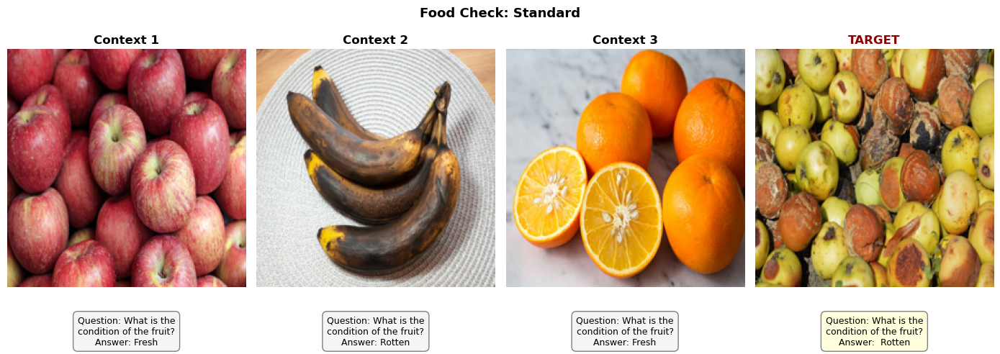

--------------------------------------------------
🔹 [Descriptive]: "fresh fruit ."


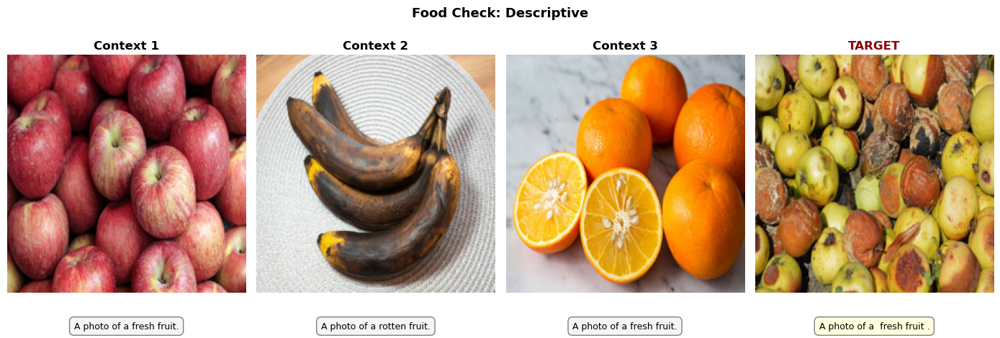

--------------------------------------------------
🔹 [List]: "Fresh"


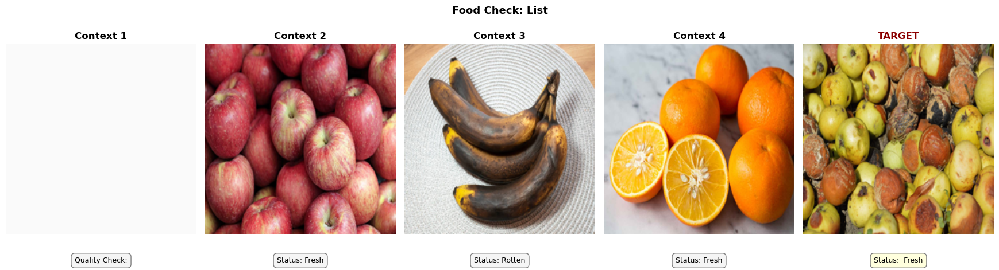

--------------------------------------------------


In [42]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT FEW-SHOT: FRUIT QUALITY (REFINED)
# ----------------------------------------------------------------------------
img_s1 = load_img("fresh_apple")    # Shiny red apple
img_s2 = load_img("rotten_banana")  # Brown/black banana
img_s3 = load_img("fresh_orange")   # Bright orange
img_t  = load_img("rotten_apple")   # Moldy/shriveled apple (Target)

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🍎 Testing few-shot food quality (Refined)...\n")
    
    # Strategy 1: Explicit Classification
    # CHANGE: Changed "Is this edible?" to "Condition?" so the answer matches the visual state directly.
    # ADDED: "###" separator to help the model distinguish where one example ends and the next begins.
    prompt_standard = [
        img_s1, "Question: What is the condition of the fruit?\nAnswer: Fresh\n",
        img_s2, "Question: What is the condition of the fruit?\nAnswer: Rotten\n",
        img_s3, "Question: What is the condition of the fruit?\nAnswer: Fresh\n",
        img_t,  "Question: What is the condition of the fruit?\nAnswer:"
    ]

    # Strategy 2: Caption Continuation (Usually the most robust)
    # CHANGE: Switched to "A photo of..." which is how these models were pre-trained (COCO format).
    prompt_desc = [
        img_s1, "A photo of a fresh fruit.\n",
        img_s2, "A photo of a rotten fruit.\n",
        img_s3, "A photo of a fresh fruit.\n",
        img_t,  "A photo of a"
    ]

    # Strategy 3: Token Alignment (Fixed)
    # CHANGE: Removed "Fresh or Rotten?" from the target. 
    # REASON: If you put the question in the target prompt, the model tries to answer the question *after* the prompt, often repeating it.
    prompt_list = [
        "Quality Check:\n",
        img_s1, "Status: Fresh\n",
        img_s2, "Status: Rotten\n",
        img_s3, "Status: Fresh\n",
        img_t,  "Status:" 
    ]

    test_cases = [("Standard", prompt_standard), ("Descriptive", prompt_desc), ("List", prompt_list)]

    for style_name, prompt_content in test_cases:
        # Increase tokens slightly just in case it wants to say "Rotten fruit" instead of just "Rotten"
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        print(f"🔹 [{style_name}]: \"{output}\"")
        visualize_result(prompt_content, output, f"Food Check: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Missing images.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT FEW-SHOT: INDUSTRIAL QUALITY CONTROL
# ----------------------------------------------------------------------------
# Note: Ensure you have images of screws/parts labeled as 'pass' or 'fail'
img_s1 = load_img("screw_2")  # Example of a Good part
img_s2 = load_img("rust_screw")    # Example of a Bad part (Rust)
# img_s3 = load_img("screw_bent_1")     # Example of a Bad part (Deformed)
img_t  = load_img("broken_screw_2")   # The mystery part to classify

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🏭 Testing few-shot industrial quality control...\n")
    
    # Strategy 1: Standard Few-Shot (QA Format)
    # Direct interrogation format
    prompt_standard = [
        img_s1, "Question: What is the quality status?\nAnswer: Pass.\n",
        img_s2, "Question: What is the quality status?\nAnswer: Fail.\n",
        # img_s3, "Question: What is the quality status?\nAnswer: Fail.\n",
        img_t,  "Question: What is the quality status?\nAnswer:"
    ]

    # Strategy 2: Descriptive Few-Shot (Prefix completion)
    # Frames the task as a captioning problem (often better for weaker instruction-tuned models)
    prompt_desc = [
        img_s1, "This is a high-quality screw.\n",
        img_s2, "This is a defective screw.\n",
        # img_s3, "This is a defective screw.\n",
        img_t,  "This is a"
    ]

    # Strategy 3: Minimalist List (Token probability focus)
    # Reduces noise, forcing the model to map image -> single token label
    prompt_list = [
        "Quality Control Log:\n",
        img_s1, "Pass\n",
        img_s2, "Fail\n",
        # img_s3, "Fail\n",
        img_t,  ""
    ]

    test_cases = [
        ("Standard Few-Shot", prompt_standard),
        ("Descriptive Completion", prompt_desc),
        ("Minimalist Pattern", prompt_list)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - using your existing generate_interleaved function
        # Note: We keep tokens low (e.g., 5) because we only want a short label
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Visualize the full context and final prediction
        visualize_result(prompt_content, output, f"QC Check: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing screw images for the few-shot test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT VISUAL AMPLIFICATION (Lion/Target)
# ----------------------------------------------------------------------------
img_s1 = load_img("dog_1")
img_s2 = load_img("cat_1")
img_s3 = load_img("horse_1")
img_t  = load_img("lion_1") 

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🦁 Testing visual amplification for Target recognition...\n")
    
    # Strategy 1: Your Double-Image Logic (Signal Amplification)
    prompt_amplified = [
        img_s1, "Question: What animal is this?\nAnswer: dog.\n",
        img_s2, "Question: What animal is this?\nAnswer: cat.\n",
        img_s3, "Question: What animal is this?\nAnswer: horse.\n",
        img_t,  # First visual signal
        img_t,  "Question: What animal is this?\nAnswer:" # Second visual signal + Question
    ]

    # Strategy 2: Triple-Image (Extreme Amplification)
    # Useful if the vision encoder is weak or the image is complex.
    prompt_triple = [
        img_s1, "Question: What animal is this?\nAnswer: dog.\n",
        img_s2, "Question: What animal is this?\nAnswer: cat.\n",
        img_s3, "Question: What animal is this?\nAnswer: horse.\n",
        img_t, img_t, img_t, "Question: What animal is this?\nAnswer:"
    ]

    # Strategy 3: Primed Amplification (Combining two best techniques)
    prompt_primed_amp = [
        img_s1, "This is a dog.\n",
        img_s2, "This is a cat.\n",
        img_s3, "This is a horse.\n",
        img_t, img_t, "This is a"
    ]

    test_cases = [
        ("Double-Image Amp", prompt_amplified),
        ("Triple-Image Amp", prompt_triple),
        ("Primed + Double Amp", prompt_primed_amp)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - using fixed generate_interleaved
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=2)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Visualize the full context and final prediction
        visualize_result(prompt_content, output, f"Amplification: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for visual amplification test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT FAST CONCEPT BINDING (Nonsense Words)
# ----------------------------------------------------------------------------
img_s1 = load_img("lion_1")
img_s2 = load_img("dog_4")
img_s3 = load_img("lion_2")
img_t  = load_img("dog_2")

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🧪 Testing rapid concept binding (Dax vs Blicket)...\n")
    
    # Strategy 1: Standard Few-Shot (Your original logic)
    prompt_standard = [
        img_s1, "Question: What is this?\nAnswer: dax.\n",
        img_s2, "Question: What is this?\nAnswer: blicket.\n",
        img_s3, "Question: What is this?\nAnswer: dax.\n",
        img_t,  "Question: What is this?\nAnswer:"
    ]

    # Strategy 2: Task Induction (Explicit Instructions)
    # Adding a rule at the start often helps Frozen models ignore their prior weights.
    prompt_induction = [
        "In this game, lions are called dax and dogs are called blicket.\n",
        img_s1, "This is a dax.\n",
        img_s2, "This is a blicket.\n",
        img_s3, "This is a dax.\n",
        img_t,  "This is a"
    ]

    # Strategy 3: Contrastive Priming (Forces the choice)
    prompt_contrast = [
        img_s1, "dax\n",
        img_s2, "blicket\n",
        img_s3, "dax\n",
        img_t,  "Question: Is this a dax or a blicket?\nAnswer:"
    ]

    test_cases = [
        ("Standard Binding", prompt_standard),
        ("Task Induction", prompt_induction),
        ("Contrastive Choice", prompt_contrast)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - we only need 1-2 tokens for the nonsense word
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=3)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Use your requested visualize_result function
        visualize_result(prompt_content, output, f"Concept Binding: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for nonsense word test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ACTION ADAPTATION (Few-Shot + Amplification)
# ----------------------------------------------------------------------------
img_s2 = load_img("person_sleeping")
img_s3 = load_img("boy_running")
img_s4 = load_img("girl_reading")
img_t  = load_img("person_eating_2")

if all([img_s2, img_s3, img_s4, img_t]):
    print(f"🍴 Testing rapid adaptation for 'Eating' action...\n")
    
    # Strategy 1: Your Amplified Few-Shot (Reinforced Signal)
    prompt_amplified = [
        img_s2, "Describe the Action?\nAnswer: Sleeping.\n",
        img_s3, "Describe the Action?\nAnswer: Running.\n",
        img_s4, "Describe the Action?\nAnswer: Reading.\n",
        img_t, img_t, img_t, img_t, # 4x Amplification
        "Describe the Action?\nAnswer:"
    ]

    # Strategy 2: Present Continuous Priming (Forces the -ing form)
    prompt_continuous = [
        img_s2, "The person is sleeping.\n",
        img_s3, "The boy is running.\n",
        img_s4, "The girl is reading.\n",
        img_t, img_t, "The person is"
    ]

    # Strategy 3: Pure Instruction + Support
    prompt_instruction = [
        "Task: Identify the action in the image.\n",
        img_s2, "Action: Sleeping\n",
        img_s3, "Action: Running\n",
        img_s4, "Action: Reading\n",
        img_t,  "Action:"
    ]

    test_cases = [
        ("Amplified VQA", prompt_amplified),
        ("Continuous Priming", prompt_continuous),
        ("Instructional Flow", prompt_instruction)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - we only need 1-2 tokens for the action word
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=3)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Use your requested visualize_result function
        visualize_result(prompt_content, output, f"Action Adaptation: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for action adaptation test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT BOOLEAN RECOGNITION (Yes/No)
# ----------------------------------------------------------------------------
img_s1 = load_img("scene_day")
img_s2 = load_img("scene_day_2")
img_t  = load_img("dog_2")

if all([img_s1, img_s2, img_t]):
    print(f"✅ Testing Boolean reasoning (Yes/No)...\n")
    
    # Strategy 1: Standard Instruction (Your logic)
    prompt_standard = [
        "Answer with Yes or No.\n",
        img_s1, "Is it sunny?\nAnswer: Yes.\n",
        img_s2, "Is it night?\nAnswer: No.\n",
        img_t,  "Question: Is it a cat?\nAnswer:"
    ]

    # Strategy 2: Direct Assertion (Simplifies the logic for the LM)
    prompt_assertion = [
        img_s1, "This is sunny: Yes.\n",
        img_s2, "This is night: No.\n",
        img_t,  "This is a cat:"
    ]

    # Strategy 3: Contrastive Signal Amplification
    # Repeating the target to ensure the 'Dog' features override the 'Cat' query
    prompt_amplified = [
        "Answer with Yes or No.\n",
        img_s1, "Is it sunny?\nAnswer: Yes.\n",
        img_s2, "Is it night?\nAnswer: No.\n",
        img_t, img_t, "Question: Is it a cat?\nAnswer:"
    ]

    test_cases = [
        ("Standard Boolean", prompt_standard),
        ("Direct Assertion", prompt_assertion),
        ("Amplified Boolean", prompt_amplified)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - strictly 1 token for Yes/No
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=2)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Use your requested visualize_result function
        visualize_result(prompt_content, output, f"Boolean VQA: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for boolean test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT CATEGORICAL ADAPTATION (Plane vs Dog/Car)
# ----------------------------------------------------------------------------
img_s1 = load_img("dog_1")
img_s2 = load_img("car_1")
img_s3 = load_img("dog_2")
img_s4 = load_img("car_2")
img_t  = load_img("plane_3")

if all([img_s1, img_s2, img_s3, img_s4, img_t]):
    print(f"✈️ Testing categorical adaptation for Plane recognition...\n")
    
    # Strategy 1: Alternating Pattern (Your original logic)
    # This tests if the model can handle "out-of-distribution" objects 
    # after being primed with two specific categories.
    prompt_alternating = [
        img_s1, "Question: What is this?\nAnswer: A dog.\n",
        img_s2, "Question: What is this?\nAnswer: A car.\n",
        img_s3, "Question: What is this?\nAnswer: A dog.\n",
        img_s4, "Question: What is this?\nAnswer: A car.\n",
        img_t,  "Question: What is this?\nAnswer:"
    ]

    # Strategy 2: Prefix Completion (The "Frozen" Paper Favorite)
    # Removing the Q&A structure often helps the model focus purely on the visual.
    prompt_prefix = [
        img_s1, "A photo of a dog.\n",
        img_s2, "A photo of a car.\n",
        img_s3, "A photo of a dog.\n",
        img_s4, "A photo of a car.\n",
        img_t,  "A photo of a"
    ]

    # Strategy 3: Category Induction
    # Explicitly telling the model it's looking at different objects.
    prompt_induction = [
        "Task: Name the object in each image.\n",
        img_s1, "dog\n",
        img_s2, "car\n",
        img_s3, "dog\n",
        img_s4, "car\n",
        img_t,  ""
    ]

    test_cases = [
        ("Alternating Q&A", prompt_alternating),
        ("Prefix Completion", prompt_prefix),
        ("Pure Induction", prompt_induction)
    ]

    for style_name, prompt_content in test_cases:
        # Generate - plane is usually 1-2 tokens
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=3)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Using the requested visualize_result function
        visualize_result(prompt_content, output, f"Categorical Adaptation: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for categorical test.")


## 5. Test Case: Encyclopedic Knowledge
**Capability:** Testing if the model can retrieve external knowledge about the visual concept (e.g., identifying an inventor).
**Prompt:** `[Image] Question: Who invented this object? Answer:`


In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ENCYCLOPEDIC KNOWLEDGE (Landmark)
# ----------------------------------------------------------------------------
key = "statue_of_liberty" 
img = load_img(key)

if img:
    print(f"🗽 Testing external knowledge retrieval...\n")
    
    # Variations to test how deep the model's retrieval goes
    variations = [
        # 1. Direct Location VQA (Your original case)
        ("Direct VQA", "Question: In which country is the landmark shown in the image located?\nAnswer:"),
        
        # 2. Specific City/Location (Narrowing the search)
        ("Specific City", "Question: In which city is this statue located?\nAnswer:"),
        
        # 3. Knowledge Priming (Retrieving the name first)
        ("Identification + Fact", "Question: What is the name of this landmark?\nAnswer:"),
        
        # 4. Contextual Completion
        ("Contextual Completion", "This famous landmark is located in the country of")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Encyclopedic answers can be longer phrases
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=25)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Using the requested visualize_result style
        visualize_result(prompt, output, f"Knowledge Retrieval")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ENCYCLOPEDIC KNOWLEDGE (Eiffel Tower)
# ----------------------------------------------------------------------------
key = "eiffel_tower" 
img = load_img(key)

if img:
    print(f"🗼 Testing landmark knowledge retrieval...\n")
    
    # Variations to test different 'memory' triggers in the LM
    variations = [
        # 1. Direct VQA (Your original case)
        ("Direct VQA", "Question: Identify the country associated with the landmark in this image.\nAnswer:"),
        
        # 2. Name + Location (Verification check)
        ("Name and City", "Question: What is the name of this tower and which city is it in?\nAnswer:"),
        
        # 3. Primed Fact Retrieval (High success for GPT-2)
        ("Primed Fact", "The landmark shown in the photo is the Eiffel Tower, which is located in"),
        
        # 4. Leading Descriptive Prompt
        ("Leading Descriptive", "A photograph of a famous landmark in the country of")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # We use the generate_interleaved function with established fixes
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=15)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Maintain the consistent visualization style
        visualize_result(prompt, output, f"Knowledge Retrieval: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ENCYCLOPEDIC KNOWLEDGE (Albert Einstein)
# ----------------------------------------------------------------------------
key = "albert_einstien" # Note: Check if filename is spelled 'einstein' or 'einstien'
img = load_img(key)

if img:
    print(f"🧠 Testing historical figure identification...\n")
    
    # Variations to test different levels of semantic retrieval
    variations = [
        # 1. Direct Name Retrieval (Your original case)
        ("Direct VQA", "Question: Name the person depicted in this image.\nAnswer:"),
        
        # 2. Professional/Historical Context (Retrieving the field of study)
        ("Profession Retrieval", "Question: What is this person famous for?\nAnswer:"),
        
        # 3. Primed Sentence (Often more accurate for famous figures)
        ("Primed Sentence", "The famous scientist shown in this photograph is"),
        
        # 4. Fill-in-the-blank Caption
        ("Caption Completion", "A black and white portrait of")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Generate - use enough tokens for full names and titles
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=15)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Consistent visualization
        visualize_result(prompt, output, f"Identity Retrieval: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found. Check filename spelling!")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ENCYCLOPEDIC KNOWLEDGE (Galileo)
# ----------------------------------------------------------------------------
key = "galileo" 
img = load_img(key)

if img:
    print(f"🔭 Testing historical figure identification (Galileo)...\n")
    
    # Variations to test different 'memory' triggers in the LM
    variations = [
        # 1. Direct Name Retrieval (Your original case)
        ("Direct VQA", "Question: Name the person depicted in this image.\nAnswer:"),
        
        # 2. Contribution Query (Retrieving what he is known for)
        ("Contribution Retrieval", "Question: What is this person famous for in science?\nAnswer:"),
        
        # 3. Primed Identity (Stronger for historical portraits)
        ("Primed Identity", "The historical figure shown in this portrait is"),
        
        # 4. Contextual Description
        ("Contextual Completion", "This is an image of the famous astronomer")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # Generate - using the fixed generate_interleaved
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=15)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Maintain the consistent visualization style
        visualize_result(prompt, output, f"Identity Retrieval: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found. Ensure 'galileo.jpg' is in your image folder.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ENCYCLOPEDIC KNOWLEDGE (Panda)
# ----------------------------------------------------------------------------
key = "panda" 
img = load_img(key)

if img:
    print(f"🐼 Testing animal origin retrieval...\n")
    
    # Variations to test how the model links the species to geography
    variations = [
        # 1. Direct Origin VQA (Your original case)
        ("Direct VQA", "This animal originates from which country?\nAnswer:"),
        
        # 2. Primed Location (Forces a proper noun/country name)
        ("Primed Location", "Question: Where do these animals live in the wild?\nAnswer: They are native to"),
        
        # 3. Categorical Knowledge (Checks if it knows the animal first)
        ("ID + Origin", "This is a giant panda. It is famous for living in"),
        
        # 4. Leading Descriptive Prompt
        ("Leading Descriptive", "A photograph of an animal found in the bamboo forests of")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # China is only 1-2 tokens, but we keep it flexible
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=4)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Consistent visualization
        visualize_result(prompt, output, f"Knowledge Retrieval: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ENCYCLOPEDIC KNOWLEDGE (Great Wall of China)
# ----------------------------------------------------------------------------
key = "great_wall_of_china" 
img = load_img(key)

if img:
    print(f"🧱 Testing landmark geography retrieval...\n")
    
    # Variations to find the most "knowledge-rich" response path
    variations = [
        # 1. Direct Country VQA (Your original case)
        ("Direct VQA", "Question: This landmark is globally iconic. Which country does it belong to?\nAnswer:"),
        
        # 2. Name Identification (Verification step)
        ("Name Retrieval", "Question: What is the name of this ancient fortification?\nAnswer:"),
        
        # 3. Knowledge Priming (High success for Frozen models)
        ("Primed Location", "The historic structure shown in this image is located in the country of"),
        
        # 4. Contextual Description
        ("Contextual Completion", "This famous wall was built many centuries ago in")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # We use the generate_interleaved function with established fixes
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=10)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Maintain the consistent visualization style
        visualize_result(prompt, output, f"Knowledge Retrieval: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found. Check if the file exists in your image path.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT SYMBOLIC KNOWLEDGE (Maple Leaf)
# ----------------------------------------------------------------------------
key = "maple_leaf" 
img = load_img(key)

if img:
    print(f"🍁 Testing symbolic knowledge retrieval...\n")
    
    # Variations to test how the model bridges biology and national symbols
    variations = [
        # 1. Direct Symbolic VQA (Your original case)
        ("Symbolic VQA", "Question: This leaf appears on the flag of which country?\nAnswer:"),
        
        # 2. Primed Location (Standard knowledge retrieval)
        ("Primed Location", "The leaf shown in the image is a national symbol of"),
        
        # 3. Object Identification (Sanity check for the vision encoder)
        ("Object ID", "Question: What specific type of leaf is this?\nAnswer: This is a"),
        
        # 4. Contextual Completion
        ("Contextual Completion", "This red leaf is the central emblem on the national flag of")
    ]

    for style_name, text_prompt in variations:
        prompt = [img, text_prompt]
        
        # 'Canada' is a single token, but we allow more for descriptive answers
        output = generate_interleaved(model, tokenizer, prompt, max_new_tokens=8)
        
        print(f"🔹 [{style_name}]")
        print(f"   Prompt: \"{text_prompt}\"")
        print(f"   Model output: \"{output}\"")
        
        # Maintain the consistent visualization style
        visualize_result(prompt, output, f"Symbolic Retrieval: {style_name}")
        print("-" * 50)
else:
    print(f"⚠️  Skipped: Image '{key}' not found.")


## 6. Test Case: Fast Concept Binding (Nonsense Words)
**Capability:** Testing if the model can learn *new* associations in-context.
**Task:** We show it a cat and call it a "dax". We show it a dog and call it a "blicket". Then we show a new cat and see if it calls it a "dax".


In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT CONCEPT BINDING (Nonsense Word: Dax)
# ----------------------------------------------------------------------------
img_s1 = load_img("dog_1")
img_s2 = load_img("dog_2")
img_t  = load_img("dog_5")

nonsense_word = "dax"

if all([img_s1, img_s2, img_t]):
    print(f"🧪 Testing rapid concept binding for '{nonsense_word}'...\n")
    
    # Variations to test binding strength vs. pre-trained bias
    variations = [
        # 1. Standard Teaching (Your original logic)
        ("Standard Teaching", [
            img_s1, f"This is a {nonsense_word}.\n",
            img_s2, f"This is a {nonsense_word}.\n",
            img_t,  "Question: What is this?\nAnswer:"
        ]),
        
        # 2. Task Induction (Pre-explaining the rules)
        # This helps the Frozen LM suppress the word 'dog'
        ("Task Induction", [
            f"In this task, we use the word {nonsense_word} for these objects.\n",
            img_s1, f"This is a {nonsense_word}.\n",
            img_s2, f"This is a {nonsense_word}.\n",
            img_t,  f"Question: What is this {nonsense_word}?\nAnswer: This is a"
        ]),
        
        # 3. Direct Caption Completion (Minimal text)
        ("Caption Completion", [
            img_s1, f"A photo of a {nonsense_word}.\n",
            img_s2, f"A photo of a {nonsense_word}.\n",
            img_t,  f"A photo of a"
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - we expect exactly 1 token (the nonsense word)
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=3)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Consistent visualization
        visualize_result(prompt_content, output, f"Concept Binding: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for concept binding test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT CONCEPT BINDING (3-Shot Dax)
# ----------------------------------------------------------------------------
img_s1 = load_img("cat_1")
img_s2 = load_img("cat_2")
img_s3 = load_img("cat_3")
img_t  = load_img("cat_5")

nonsense_word = "dax"

if all([img_s1, img_s2, img_s3, img_t]):
    print(f"🧪 Testing 3-shot concept binding for '{nonsense_word}'...\n")
    
    variations = [
        # 1. Standard Q&A Few-Shot (Your logic)
        ("Standard 3-Shot", [
            img_s1, f"This is a {nonsense_word}.\n",
            img_s2, f"This is a {nonsense_word}.\n",
            img_s3, f"This is a {nonsense_word}.\n",
            img_t,  "Question: What is this?\nAnswer:"
        ]),
        
        # 2. Descriptive Flow (Prefix completion)
        # Often the most successful for Frozen models
        ("Descriptive 3-Shot", [
            img_s1, f"A photo of a {nonsense_word}.\n",
            img_s2, f"A photo of a {nonsense_word}.\n",
            img_s3, f"A photo of a {nonsense_word}.\n",
            img_t,  "A photo of a"
        ]),
        
        # 3. Categorical List (Minimalist structure)
        ("List-based Binding", [
            f"Objects in this category are called {nonsense_word}.\n",
            img_s1, f"{nonsense_word}\n",
            img_s2, f"{nonsense_word}\n",
            img_s3, f"{nonsense_word}\n",
            img_t,  ""
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - using fixed generate_interleaved
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Use your requested visualize_result function
        visualize_result(prompt_content, output, f"3-Shot Binding: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for 3-shot binding test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT CONCEPT BINDING (4-Shot Dax)
# ----------------------------------------------------------------------------
img_s1 = load_img("dog_1")
img_s2 = load_img("dog_2")
img_s3 = load_img("dog_3")
img_s4 = load_img("dog_5")
img_t  = load_img("dog_4")

nonsense_word = "dax"

if all([img_s1, img_s2, img_s3, img_s4, img_t]):
    print(f"🧪 Testing 4-shot concept binding for '{nonsense_word}'...\n")
    
    variations = [
        # 1. Reinforced Q&A (Your original logic)
        ("Reinforced 4-Shot", [
            img_s1, f"This is a {nonsense_word}.\n",
            img_s2, f"This is a {nonsense_word}.\n",
            img_s3, f"This is a {nonsense_word}.\n",
            img_s4, f"This is a {nonsense_word}.\n",
            img_t,  "Question: What is this?\nAnswer:"
        ]),
        
        # 2. Pattern Induction (Highest probability for GPT-2 weights)
        ("Pattern Induction", [
            f"Training data: {nonsense_word} identification.\n",
            img_s1, f"Type: {nonsense_word}\n",
            img_s2, f"Type: {nonsense_word}\n",
            img_s3, f"Type: {nonsense_word}\n",
            img_s4, f"Type: {nonsense_word}\n",
            img_t,  "Type:"
        ]),
        
        # 3. Direct Visual Assertion
        ("Visual Assertion", [
            img_s1, f"{nonsense_word}\n",
            img_s2, f"{nonsense_word}\n",
            img_s3, f"{nonsense_word}\n",
            img_s4, f"{nonsense_word}\n",
            img_t,  f"Question: Is this a {nonsense_word}?\nAnswer:"
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - we want the model to output 'dax'
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Consistent visualization
        visualize_result(prompt_content, output, f"4-Shot Binding: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for 4-shot binding test.")

## 7. Test Case: Real-Name Binding (One-Shot Classification)
Capability: Testing if the model can perform standard classification after seeing just one labeled example. Task: Unlike "nonsense" words, here we use the actual class name. We show the model a Support Image of a lion and the text "This is a photo of a lion." We then show a Target Image (a different lion) and ask "Question: What animal is this?" to see if it successfully retrieves the label "lion" from the immediate context.

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT CONCEPT BINDING (4-Shot Dax)
# ----------------------------------------------------------------------------
img_s1 = load_img("dog_1")
img_s2 = load_img("dog_2")
img_s3 = load_img("dog_3")
img_s4 = load_img("dog_5")
img_t  = load_img("dog_4")

nonsense_word = "dax"

if all([img_s1, img_s2, img_s3, img_s4, img_t]):
    print(f"🧪 Testing 4-shot concept binding for '{nonsense_word}'...\n")
    
    variations = [
        # 1. Reinforced Q&A (Your original logic)
        ("Reinforced 4-Shot", [
            img_s1, f"This is a {nonsense_word}.\n",
            img_s2, f"This is a {nonsense_word}.\n",
            img_s3, f"This is a {nonsense_word}.\n",
            img_s4, f"This is a {nonsense_word}.\n",
            img_t,  "Question: What is this?\nAnswer:"
        ]),
        
        # 2. Pattern Induction (Highest probability for GPT-2 weights)
        ("Pattern Induction", [
            f"Training data: {nonsense_word} identification.\n",
            img_s1, f"Type: {nonsense_word}\n",
            img_s2, f"Type: {nonsense_word}\n",
            img_s3, f"Type: {nonsense_word}\n",
            img_s4, f"Type: {nonsense_word}\n",
            img_t,  "Type:"
        ]),
        
        # 3. Direct Visual Assertion
        ("Visual Assertion", [
            img_s1, f"{nonsense_word}\n",
            img_s2, f"{nonsense_word}\n",
            img_s3, f"{nonsense_word}\n",
            img_s4, f"{nonsense_word}\n",
            img_t,  f"Question: Is this a {nonsense_word}?\nAnswer:"
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - we want the model to output 'dax'
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output}\"")
        
        # Consistent visualization
        visualize_result(prompt_content, output, f"4-Shot Binding: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Missing images for 4-shot binding test.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT CONTRASTIVE BINDING (Blicket vs. Dax)
# ----------------------------------------------------------------------------
img_dog1 = load_img("dog_1")
img_cat1 = load_img("cat_1")
img_dog2 = load_img("dog_2")
img_target_cat = load_img("cat_2") # Corrected variable name for clarity

if all([img_dog1, img_cat1, img_dog2, img_target_cat]):
    print(f"🧪 Testing contrastive binding: Dogs are 'blickets', Cats are 'daxes'...\n")
    
    variations = [
        # 1. Your Original Sequence (Mixed support)
        ("Mixed Support", [
            img_dog1, "This is a blicket.\n",
            img_cat1, "This is a dax.\n",
            img_dog2, "This is a blicket.\n",
            img_target_cat, "This is a"
        ]),
        
        # 2. Blocked Support (Grouping concepts can help the LM)
        ("Blocked Support", [
            img_dog1, "blicket\n",
            img_dog2, "blicket\n",
            img_cat1, "dax\n",
            img_target_cat, ""
        ]),
        
        # 3. Explicit Contrastive VQA
        ("Contrastive VQA", [
            img_dog1, "Question: Is this a dax or a blicket?\nAnswer: blicket.\n",
            img_cat1, "Question: Is this a dax or a blicket?\nAnswer: dax.\n",
            img_target_cat, "Question: Is this a dax or a blicket?\nAnswer:"
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - looking for a single word
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output.strip()}\"")
        
        visualize_result(prompt_content, output, f"Contrastive Binding: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Image loading failed. Ensure dog_1, cat_1, dog_2, and cat_2 exist.")

## 8. Test Case: Multimodal Reasoning (Deep Understanding)
Capability: Testing if the model can infer latent properties (like weight, material, or texture) that are defined purely by the context, rather than just visual appearance. Task: We provide a definition in the context: Image A (a car) is described as "Heavy". Image B (a phone) is described as "Light". We then present Image A again and ask: "Question: Is this object heavy or light?" The model must understand the property assignment from the support set to answer correctly, as "heavy" is not a visual class name but a concept bound to that image.

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT ONE-SHOT CLASSIFICATION (Lion)
# ----------------------------------------------------------------------------
img_s1 = load_img("lion_1")
img_t  = load_img("lion_3") 

if img_s1 and img_t:
    print(f"🦁 Testing one-shot classification...\n")
    
    variations = [
        # 1. Standard VQA (Your original logic)
        ("Standard One-Shot", [
            img_s1, "This is a photo of a lion.\n",
            img_t,  "Question: What animal is this?\nAnswer:"
        ]),
        
        # 2. Sequential Completion (Streamlined for GPT-style weights)
        ("Sequential Completion", [
            img_s1, "A lion.\n",
            img_t,  "A"
        ]),
        
        # 3. Instruction-Led One-Shot
        ("Instruction-Led", [
            "Task: Identify the animal in the photograph.\n",
            img_s1, "Lion\n",
            img_t,  ""
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - we expect 1-3 tokens
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output.strip()}\"")
        
        visualize_result(prompt_content, output, f"One-Shot: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Ensure lion_1 and lion_3 exist in your images folder.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT PROPERTY REASONING (Heavy vs. Light)
# ----------------------------------------------------------------------------
img_A = load_img("car_1")   # Heavy
img_B = load_img("phone_2") # Light
img_C = load_img("car_3")   # Query

if all([img_A, img_B, img_C]):
    print(f"⚖️ Testing property reasoning and prior-bias override...\n")
    
    variations = [
        # 1. Standard Comparison (Your original logic)
        ("Standard Comparison", [
            img_A, "This object is heavy.\n",
            img_B, "This object is light.\n",
            img_C, "Question: Is this object light or heavy?\nAnswer:"
        ]),
        
        # 2. Forced Choice (Forces the model to pick from the two options)
        ("Forced Choice", [
            "Classify based on weight: heavy or light.\n",
            img_A, "heavy\n",
            img_B, "light\n",
            img_C, ""
        ]),
        
        # 3. Descriptive Attribute Mapping
        ("Attribute Mapping", [
            img_A, "Weight: Heavy\n",
            img_B, "Weight: Light\n",
            img_C, "Weight:"
        ])
    ]

    for style_name, prompt_content in variations:
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output.strip()}\"")
        
        visualize_result(prompt_content, output, f"Property Reasoning: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Ensure car_2, phone_3, and car_4 are in your images folder.")

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT PROPERTY REASONING (Attribute: Glasses)
# ----------------------------------------------------------------------------
img_A = load_img("man_with_glasses")
img_B = load_img("man_with_glasses_2")
img_C = load_img("man_with_glasses_3")

if all([img_A, img_B, img_C]):
    print(f"👓 Testing fine-grained attribute detection (Glasses)...\n")
    
    variations = [
        # 1. Standard Boolean VQA (Your original logic)
        ("Standard Boolean", [
            img_A, "This is a man.\n",
            img_B, "This is a man.\n",
            img_C, "Question: Does the man have glasses?\nAnswer:"
        ]),
        
        # 2. Descriptive Priming (Forces the model to 'look' at the eyes)
        ("Descriptive Priming", [
            img_A, "In this photo, the man is wearing glasses.\n",
            img_B, "In this photo, the man is wearing glasses.\n",
            img_C, "In this photo, the man is"
        ]),
        
        # 3. Direct Feature Check (Minimalist)
        ("Direct Feature Check", [
            "Detect accessories: glasses or no glasses.\n",
            img_A, "glasses\n",
            img_B, "glasses\n",
            img_C, ""
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - Yes/No or specific attribute word
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output.strip()}\"")
        
        visualize_result(prompt_content, output, f"Attribute Detection: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Ensure man_with_glasses 1, 2, and 3 are in your folder.")
    

In [ ]:
# ----------------------------------------------------------------------------
# MULTI-PROMPT PROPERTY REASONING (Functional Knowledge: toolX)
# ----------------------------------------------------------------------------
img_A = load_img("hammer_1")
img_B = load_img("hammer_2")
img_C = load_img("hammer_3")

nonsense_word = "toolX"

if all([img_A, img_B, img_C]):
    print(f"🔨 Testing functional reasoning for '{nonsense_word}'...\n")
    
    variations = [
        # 1. Standard Functional VQA (Your original case)
        ("Functional VQA", [
            img_A, f"This is a {nonsense_word}.\n",
            img_B, f"This is a {nonsense_word}.\n",
            img_C, f"Question: Is {nonsense_word} used for woodworking?\nAnswer:"
        ]),
        
        # 2. Descriptive Utility (Helps the model bridge the gap to action)
        ("Utility Priming", [
            img_A, f"A {nonsense_word} is used to hit nails.\n",
            img_B, f"A {nonsense_word} is used to hit nails.\n",
            img_C, f"Because this {nonsense_word} is used to hit nails, it is a great tool for"
        ]),
        
        # 3. Categorical Association
        ("Category Binding", [
            img_A, f"Category: {nonsense_word}\n",
            img_B, f"Category: {nonsense_word}\n",
            img_C, f"Question: Does a {nonsense_word} belong in a carpenter's toolbox?\nAnswer:"
        ])
    ]

    for style_name, prompt_content in variations:
        # Generate - we want to see 'Yes' or 'woodworking'
        output = generate_interleaved(model, tokenizer, prompt_content, max_new_tokens=5)
        
        print(f"🔹 [{style_name}]")
        print(f"   Model output: \"{output.strip()}\"")
        
        visualize_result(prompt_content, output, f"Functional Reasoning: {style_name}")
        print("-" * 50)
else:
    print("⚠️  Skipped: Ensure hammer_1, 2, and 3 are in your images folder.")